# STS Project
## Introduction
*Jupyter Notebook* of the STS (Semantic Textual Similarity) Project of **Introduction to Human Language Technologies** course from UPC in MAI (Master of Artificial Intelligence).

This project has been done by:
- David Dueñas Gaviria
- Kevin David Rosales Santana

The statement is as follows:
- Use data set and description of task Semantic Textual Similarity in SemEval 2012.

- Implement some approaches to detect paraphrase using sentence similarity metrics.

    - Explore some lexical dimensions.
    - Explore the syntactic dimension alone.
    - Explore the combination of both previous.
    
- Add new components at your choice (optional).

- Not word neither sentence embeddings should be allowed.

- Compare and comment the results achieved by these approaches among them and among the official results.

- Send files to raco in IHLT STS Project before the oral presentation:

    - Jupyter notebook: `sts-[Student1]-[Student2].ipynb`

    - Slides: `sts-[Student1]-[Student2].pdf`

#### Quick notes about similarities and performance measure.
    
- In order to measure the similarity between each pair of sentences, the [*Jaccard distance*](https://www.nltk.org/api/nltk.metrics.html#nltk.metrics.distance.jaccard_distance) will be used:

    - $ Similarity = 1 - Jaccard_{Distance} $

    - $ Jaccard_{Distance} = \frac{|A \cap B |}{|A \cup B|} $

- The [*Pearson correlation coefficient*](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.pearsonr.html) will be used to measure the relation between our similarities and the proposed similarities from the *Gold Standard*.  The coefficient varies between -1 and +1, with 0 implying no correlation. Correlations of -1 and +1 imply an exact linear relationship.

- **Important note**: notice that in each section, the *Train* set could be treated in order to use its results in sections 2.3.3 and 2.3.4 (which are systems that will try to learn the underlying patterns behind the different obtained similarities). However, the *Test* set is the default set used if no learning process is required.

## Imports

In [1]:
import nltk, re, dill
import numpy as np

from nltk import word_tokenize, pos_tag, ne_chunk
from nltk.stem import WordNetLemmatizer
from nltk.wsd import lesk
from nltk.tag import CRFTagger
from nltk.metrics import jaccard_distance
from nltk.corpus import stopwords
from nltk.corpus import wordnet as wn
from nltk.parse.corenlp import CoreNLPDependencyParser
from tensorflow import keras
from tensorflow.keras import layers, models
from scipy.stats import pearsonr

## 1. Data Preparation
This section covers the preparation of the Input Data. The data used along the IHLT course are mostly from the *trial* set. Nevertheless, in this project, the *test* set will be used in order to compute the similarities and measure the performance of the different proposed models.

The input data is composed by five different files:
- `STS.input.MSRpar.txt`
- `STS.input.MSRvid.txt`
- `STS.input.SMTeuroparl.txt`
- `STS.input.surprise.OnWN.txt`
- `STS.input.surprise.SMTnews.txt`

Therefore, the proposed pairs of sentences will be formed by the concatenation of the five different proposed inputs.

The variable `sw` will store the set of english stopwords, which will be used in several different approaches.

In [2]:
pairs = list()        # Default set -> Test set
train_pairs = list()

sw = set(stopwords.words('english'))

input_files = ['STS.input.MSRpar.txt',
               'STS.input.MSRvid.txt',
               'STS.input.SMTeuroparl.txt',
               'STS.input.surprise.OnWN.txt',
               'STS.input.surprise.SMTnews.txt']

input_files_train = ['STS.input.MSRpar.txt',
                     'STS.input.MSRvid.txt',
                     'STS.input.SMTeuroparl.txt']

for file in input_files:
    with open('inputs/test-gold/' + file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            line = nltk.TabTokenizer().tokenize(line.strip())
            pairs.append((line[0], line[1]))
            
for file in input_files_train:
    with open('inputs/train/' + file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            line = nltk.TabTokenizer().tokenize(line.strip())
            train_pairs.append((line[0], line[1]))

# Test pairs
for index, pair in enumerate(pairs, 1):
    print(str(index) + ".", pair)

1. ('The problem likely will mean corrective changes before the shuttle fleet starts flying again.', 'He said the problem needs to be corrected before the space shuttle fleet is cleared to fly again.')
2. ('The technology-laced Nasdaq Composite Index .IXIC inched down 1 point, or 0.11 percent, to 1,650.', "The broad Standard & Poor's 500 Index .SPX inched up 3 points, or 0.32 percent, to 970.")
3. ('"It\'s a huge black eye," said publisher Arthur Ochs Sulzberger Jr., whose family has controlled the paper since 1896.', '"It\'s a huge black eye," Arthur Sulzberger, the newspaper\'s publisher, said of the scandal.')
4. ('SEC Chairman William Donaldson said there is a "building confidence out there that the cop is on the beat."', '"I think there\'s a building confidence that the cop is on the beat."')
5. ('Vivendi shares closed 1.9 percent at 15.80 euros in Paris after falling 3.6 percent on Monday.', 'In New York, Vivendi shares were 1.4 percent down at $18.29.')
6. ("Myanmar's pro-democr

2492. ('make or become brighter or lighter', 'make lighter or brighter.')
2493. ('actors in a play', 'the actors in a play.')
2494. ("take someone's soul into heaven", "take up someone's soul into heaven.")
2495. ('Discipline in personal or social activities.', 'discipline in personal and social activities.')
2496. ('a person eating a meal, often in a restaurant', 'a person eating a meal (especially in a restaurant).')
2497. ('A sudden (emotional) outburst.', 'a sudden outburst.')
2498. ('make or become harder', 'make hard or harder.')
2499. ('the introductory portion of a story', 'the introductory section of a story.')
2500. ('work material with a tool', 'work with a tool.')
2501. ('make or become less strict or severe', 'make less severe or strict.')
2502. ('support by placing on or against something solid', 'support by placing against something solid or rigid.')
2503. ('Part, cease, or break association with (something).', 'part; cease or break association with.')
2504. ('have the f

In [3]:
print("Number of pairs of sentences:", len(pairs))

Number of pairs of sentences: 3108


Furthermore, it is required to read the already mentioned Gold Standard file. This file contains the correct similarity for each read pair of sentences. Consequently, these values will be utilized in the measurement of the performance of the proposed models.

In [4]:
with open('inputs/test-gold/STS.gs.ALL.txt','r') as f:
    gs = [float(line) for line in f.readlines()]

train_gs = list()

gs_files_train = ['STS.gs.MSRpar.txt',
                  'STS.gs.MSRvid.txt',
                  'STS.gs.SMTeuroparl.txt']

for file in gs_files_train:
    with open('inputs/train/' + file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            train_gs.append(float(line))


print("Gold standard size:", len(gs))

Gold standard size: 3108


## 2. Paraphrase detection using different approaches

The paraphrase detection will be performed using different approaches:

- First, different **Lexical Dimension** approaches will be analyzed such as *Words Tokenization*, *Lemma Tokenization* and *Lexical Semantics*. 

- After that, the **Syntactic Dimension** will be studied with *Word Sense Disambiguation* and *Word Sequences*.

- Finally, some systems based on **combinations of both dimensions** will be built taking into account the results of the mentioned previous approaches.

### 2.1 Lexical Dimensions

### 2.1.1 Words tokenization

In this basic approach, the word tokenization will be utilized for each pair of sentences:

- `wt_pairs`: contains the basic word tokenization approach.
- `l_wt_pairs`: contains the `wt_pairs` approach in lower case.
- `l_sw_wt_pairs`: contains the `l_wt_pairs` approach without stopwords.
- `l_sw_jw_wt_pairs`: contains the `l_sw_wt_pairs` approach using only words.

The word tokenization will be performed using the `nltk` function `word_tokenize(sentence)`. Notice that the loaded `sw` will be used to filter the stopwords in `l_sw_*_pairs` approaches and the package `re` will be used to obtain only words (*i.e.* no punctuation marks) in the `l_sw_jw_wt_pairs` approach.

In [5]:
wt_pairs = [(nltk.word_tokenize(p[0]), nltk.word_tokenize(p[1])) for p in pairs]
train_wt_pairs = [(nltk.word_tokenize(p[0]), nltk.word_tokenize(p[1])) for p in train_pairs]

l_wt_pairs = list()
l_sw_wt_pairs = list()
l_sw_jw_wt_pairs = list()

train_l_sw_jw_wt_pairs = list()

for pair in wt_pairs:
    l_wt_pairs.append(([w.lower() for w in pair[0]],
                       [w.lower() for w in pair[1]]))
    l_sw_wt_pairs.append(([w.lower() for w in pair[0] if w.lower() not in sw],
                          [w.lower() for w in pair[1] if w.lower() not in sw]))
    l_sw_jw_wt_pairs.append(([w.lower() for w in pair[0] if w.lower() not in sw and re.search(r"\w", w)],
                             [w.lower() for w in pair[1] if w.lower() not in sw and re.search(r"\w", w)]))
    
for pair in train_wt_pairs:
    train_l_sw_jw_wt_pairs.append(([w.lower() for w in pair[0] if w.lower() not in sw and re.search(r"\w", w)],
                                   [w.lower() for w in pair[1] if w.lower() not in sw and re.search(r"\w", w)]))

# Basic approach visualization
for index, pair in enumerate(wt_pairs, 1):
    print(str(index) + ".", pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'changes', 'before', 'the', 'shuttle', 'fleet', 'starts', 'flying', 'again', '.'], ['He', 'said', 'the', 'problem', 'needs', 'to', 'be', 'corrected', 'before', 'the', 'space', 'shuttle', 'fleet', 'is', 'cleared', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'Nasdaq', 'Composite', 'Index', '.IXIC', 'inched', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'Standard', '&', 'Poor', "'s", '500', 'Index', '.SPX', 'inched', 'up', '3', 'points', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'said', 'publisher', 'Arthur', 'Ochs', 'Sulzberger', 'Jr.', ',', 'whose', 'family', 'has', 'controlled', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'Arthur', 'Sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'said', 'of', 'the', 'scandal', '.'

1541. (['Mr', 'President', ',', 'I', 'rise', 'in', 'defence', 'of', 'the', 'workers', 'in', 'the', 'industry', '.'], ['Mr', 'President', ',', 'I', 'wish', 'to', 'take', 'the', 'protection', 'of', 'workers', 'of', 'this', 'sector', '.']) 

1542. (['Thank', 'you', ',', 'Commissioner', '.'], ['Thank', 'you', ',', 'Commissioner', '.']) 

1543. (['Amendment', 'No', '7', 'proposes', 'certain', 'changes', 'in', 'the', 'references', 'to', 'paragraphs', '.'], ['Amendment', '7', 'proposes', 'certain', 'modifications', 'in', 'the', 'references', 'to', 'the', 'paragraphs', '.']) 

1544. (['The', 'leaders', 'have', 'now', 'been', 'given', 'a', 'new', 'chance', 'and', 'let', 'us', 'hope', 'they', 'seize', 'it', '.'], ['The', 'leaders', 'benefit', 'today', 'of', 'a', 'new', 'chance', 'and', 'thus', 'let', 'the', 'matter', '.']) 

1545. (['I', 'am', 'one', 'of', 'those', 'Members', 'who', 'attends', 'sittings', 'quite', 'faithfully', '.'], ['I', 'am', 'one', 'of', 'the', 'Members', 'who', 'are', 'rath

**Comparison and comments of the results achieved by this approach among them and among the official results (Similarities & *Pearson Correlation Coefficient*).**

In [6]:
wt_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in wt_pairs]
l_wt_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_wt_pairs]
l_sw_wt_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_sw_wt_pairs]
l_sw_jw_wt_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_sw_jw_wt_pairs]

train_l_sw_jw_wt_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in train_l_sw_jw_wt_pairs]

print("Similarities (word tokenization):\n")
for index, similarity in enumerate(wt_similarities):
    print(str(index + 1) + ".", similarity)

Similarities (word tokenization):

1. 0.28
2. 0.27586206896551724
3. 0.5555555555555556
4. 0.5909090909090908
5. 0.19999999999999996
6. 0.4878048780487805
7. 0.34782608695652173
8. 0.5405405405405406
9. 0.6428571428571428
10. 0.55
11. 0.4117647058823529
12. 0.40740740740740744
13. 0.5
14. 0.3846153846153846
15. 0.3076923076923077
16. 0.4516129032258065
17. 0.4054054054054054
18. 0.5217391304347826
19. 0.4444444444444444
20. 0.3571428571428571
21. 0.30434782608695654
22. 0.4242424242424242
23. 0.7307692307692308
24. 0.64
25. 0.43999999999999995
26. 0.5714285714285714
27. 0.65625
28. 0.2857142857142857
29. 0.3421052631578947
30. 0.4736842105263158
31. 0.6538461538461539
32. 0.4
33. 0.47619047619047616
34. 0.3913043478260869
35. 0.4782608695652174
36. 0.6785714285714286
37. 0.46153846153846156
38. 0.33333333333333337
39. 0.5161290322580645
40. 0.5666666666666667
41. 0.5333333333333333
42. 0.8214285714285714
43. 0.4545454545454546
44. 0.4482758620689655
45. 0.6551724137931034
46. 0.3000000

2447. 0.2857142857142857
2448. 0.4285714285714286
2449. 0.33333333333333337
2450. 0.4285714285714286
2451. 0.2666666666666667
2452. 0.2857142857142857
2453. 0.41666666666666663
2454. 0.25
2455. 0.5714285714285714
2456. 0.4285714285714286
2457. 0.6
2458. 0.5
2459. 0.34782608695652173
2460. 0.5
2461. 0.625
2462. 0.7333333333333334
2463. 0.5714285714285714
2464. 0.6666666666666667
2465. 0.5714285714285714
2466. 0.6
2467. 0.625
2468. 0.75
2469. 0.7142857142857143
2470. 0.8333333333333334
2471. 0.5
2472. 0.625
2473. 0.5555555555555556
2474. 0.5714285714285714
2475. 0.6428571428571428
2476. 0.8
2477. 0.4285714285714286
2478. 0.7
2479. 0.625
2480. 0.5
2481. 0.6666666666666667
2482. 0.75
2483. 0.625
2484. 0.6
2485. 0.4285714285714286
2486. 0.5
2487. 0.5454545454545454
2488. 0.625
2489. 0.4285714285714286
2490. 0.6363636363636364
2491. 0.4444444444444444
2492. 0.6666666666666667
2493. 0.6666666666666667
2494. 0.75
2495. 0.5555555555555556
2496. 0.5
2497. 0.375
2498. 0.5
2499. 0.625
2500. 0.6666

In [7]:
print("Pearson correlation (word tokenization):", pearsonr(gs, wt_similarities)[0])
print("Pearson correlation (word tokenization + lowercase):", pearsonr(gs, l_wt_similarities)[0])
print("Pearson correlation (word tokenization + lowercase + no stopwords):", pearsonr(gs, l_sw_wt_similarities)[0])
print("Pearson correlation (word tokenization + lowercase + no stopwords + just words):", pearsonr(gs, l_sw_jw_wt_similarities)[0])

Pearson correlation (word tokenization): 0.3576889958413405
Pearson correlation (word tokenization + lowercase): 0.4030921572160367
Pearson correlation (word tokenization + lowercase + no stopwords): 0.4823471916155675
Pearson correlation (word tokenization + lowercase + no stopwords + just words): 0.5605613209285878


As it can be observed, the *Pearson Correlation* is improved by adding the utilization of different minor techniques (*e.g.* use of lowercase, regular expressions, stopwords...).

For example, if the first pair of sentences is analyzed in each approach:

In [8]:
print("Word tokenization approach (similarity: " + str(round(wt_similarities[1]*5, 3)) + "/5.0, gs: " + str(gs[1]) + "/5.0):")
print("\nFirst sentence:", wt_pairs[1][0])
print("Second sentence:", wt_pairs[1][1])

Word tokenization approach (similarity: 1.379/5.0, gs: 0.8/5.0):

First sentence: ['The', 'technology-laced', 'Nasdaq', 'Composite', 'Index', '.IXIC', 'inched', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.']
Second sentence: ['The', 'broad', 'Standard', '&', 'Poor', "'s", '500', 'Index', '.SPX', 'inched', 'up', '3', 'points', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']


There are some words located in both sentences (*e.g.* 'Index', 'inched', 'percent', 'to'...). Therefore, the similarity is greater than expected as these sentences are on different topics (even if they both refer to the economy field. Note the *Gold Standard* value in the `print`).

Nevertheless, if other approaches are studied:

In [9]:
print("Word tokenization + lowercase approach (similarity: " + str(round(l_wt_similarities[1]*5, 3)) + "/5.0, gs: " + str(gs[1]) + "/5.0):")
print("\nFirst sentence:", l_wt_pairs[1][0])
print("Second sentence:", l_wt_pairs[1][1])

print("\nWord tokenization + lowercase + no stopwords approach (similarity: " + str(round(l_sw_wt_similarities[1]*5, 3)) + "/5.0, gs: " + str(gs[1]) + "/5.0):")
print("\nFirst sentence:", l_sw_wt_pairs[1][0])
print("Second sentence:", l_sw_wt_pairs[1][1])

print("\nWord tokenization + lowercase + no stopwords + just words approach (similarity: " + str(round(l_sw_jw_wt_similarities[1]*5, 3)) + "/5.0, gs: " + str(gs[1]) + "/5.0):")
print("\nFirst sentence:", l_sw_jw_wt_pairs[1][0])
print("Second sentence:", l_sw_jw_wt_pairs[1][1])

Word tokenization + lowercase approach (similarity: 1.379/5.0, gs: 0.8/5.0):

First sentence: ['the', 'technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inched', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.']
Second sentence: ['the', 'broad', 'standard', '&', 'poor', "'s", '500', 'index', '.spx', 'inched', 'up', '3', 'points', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']

Word tokenization + lowercase + no stopwords approach (similarity: 1.042/5.0, gs: 0.8/5.0):

First sentence: ['technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inched', '1', 'point', ',', '0.11', 'percent', ',', '1,650', '.']
Second sentence: ['broad', 'standard', '&', 'poor', "'s", '500', 'index', '.spx', 'inched', '3', 'points', ',', '0.32', 'percent', ',', '970', '.']

Word tokenization + lowercase + no stopwords + just words approach (similarity: 0.714/5.0, gs: 0.8/5.0):

First sentence: ['technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inch

This approach is improved by adding minor changes like the filtering of stopwords and punctuation marks. 

For example, in the *Word tokenization + lowercase + no stopwords approach*, words like 'to' (stopwords) are not counted and the *Jaccard similarity* is lower than in the basic approach. This technique supposes that stopwords do not add any relevant meaning in the sentence, so they should get removed.

Finally, if the punctuation marks get removed too using regular expressions, the similarity gets a lower value than in the previous approaches. The computed similarity in this case is the nearest to the suggested by the *Gold Standard* for this pair (*i.e.* 0.8). This technique supposes that punctuation marks should not be taken into consideration in the sentences when a paraphrase detection is being performed.

Notice that this last approach (*Word tokenization + lowercase + no stopwords + just words approach*) gets the best *Pearson Correlation Coefficient* with respect to this section **(*i.e.* 0.561)**. This study of these different minor changes will be repeated in the following sections in order to analyze how they can help the improvement of the paraphrase detection.

### 2.1.2 Lemma tokenization (PoS)

An approach with lemmas will be tested for each pair of sentences:

- `lemmatize(pair,lower=bool)`: function to lemmatize, with a parameter to lower the words of the pairs.

In [10]:
wnl = WordNetLemmatizer()

def lemmatize(p, lower=False):
    try:
        return wnl.lemmatize(p[0].lower(), pos=p[1][0].lower())
    except:
        if lower:
            return p[0].lower()
        return p[0]

Taking each pair of sentences extracted from `pairs`, each sentence is tokenized by words:

In [11]:
pairs_tokenized = [(nltk.word_tokenize(p[0]), nltk.word_tokenize(p[1])) for p in pairs]
train_pairs_tokenized = [(nltk.word_tokenize(p[0]), nltk.word_tokenize(p[1])) for p in train_pairs]

for index, pair in enumerate(pairs_tokenized):
    print(str(index + 1) + ".", pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'changes', 'before', 'the', 'shuttle', 'fleet', 'starts', 'flying', 'again', '.'], ['He', 'said', 'the', 'problem', 'needs', 'to', 'be', 'corrected', 'before', 'the', 'space', 'shuttle', 'fleet', 'is', 'cleared', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'Nasdaq', 'Composite', 'Index', '.IXIC', 'inched', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'Standard', '&', 'Poor', "'s", '500', 'Index', '.SPX', 'inched', 'up', '3', 'points', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'said', 'publisher', 'Arthur', 'Ochs', 'Sulzberger', 'Jr.', ',', 'whose', 'family', 'has', 'controlled', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'Arthur', 'Sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'said', 'of', 'the', 'scandal', '.'

1630. (['Neither', 'was', 'there', 'a', 'qualified', 'majority', 'within', 'this', 'House', 'to', 'revert', 'to', 'Article', '272', '.'], ['There', 'was', 'no', 'qualified', 'majority', 'in', 'this', 'Parliament', 'to', 'go', 'back', 'to', 'Article', '272', '.']) 

1631. (['It', 'is', 'our', 'job', 'to', 'continue', 'to', 'support', 'Latvia', 'with', 'the', 'integration', 'of', 'the', 'Russian', 'population', '.'], ['It', 'is', 'of', 'our', 'duty', 'to', 'continue', 'to', 'support', 'Latvia', 'on', 'the', 'question', 'of', 'the', 'integration', 'of', 'the', 'Russian', 'population', '.']) 

1632. (['Unfortunately', ',', 'others', 'separate', 'on', 'the', 'basis', 'of', 'accumulated', 'hatred', '.'], ['Other', 'separate', 'unfortunately', 'because', 'of', 'a', 'grudge', 'accumulated', '.']) 

1633. (['Amendment', 'No', '7', 'proposes', 'certain', 'changes', 'in', 'the', 'references', 'to', 'paragraphs', '.'], ['Amendment', '7', 'proposes', 'certain', 'modifications', 'in', 'the', 'refere

To compute lemmas, the use of WordNet's built-in morphy function `pos_tag` from `nltk` is necessary.

In [12]:
pairs_pos = [(pos_tag(p[0]), pos_tag(p[1])) for p in pairs_tokenized]
train_pairs_pos = [(pos_tag(p[0]), pos_tag(p[1])) for p in train_pairs_tokenized]

for index, pair in enumerate(pairs_pos):
    print(str(index + 1) + ".", pair, '\n')

1. ([('The', 'DT'), ('problem', 'NN'), ('likely', 'RB'), ('will', 'MD'), ('mean', 'VB'), ('corrective', 'JJ'), ('changes', 'NNS'), ('before', 'IN'), ('the', 'DT'), ('shuttle', 'JJ'), ('fleet', 'NN'), ('starts', 'NNS'), ('flying', 'VBG'), ('again', 'RB'), ('.', '.')], [('He', 'PRP'), ('said', 'VBD'), ('the', 'DT'), ('problem', 'NN'), ('needs', 'VBZ'), ('to', 'TO'), ('be', 'VB'), ('corrected', 'VBN'), ('before', 'IN'), ('the', 'DT'), ('space', 'NN'), ('shuttle', 'NN'), ('fleet', 'NN'), ('is', 'VBZ'), ('cleared', 'VBN'), ('to', 'TO'), ('fly', 'VB'), ('again', 'RB'), ('.', '.')]) 

2. ([('The', 'DT'), ('technology-laced', 'JJ'), ('Nasdaq', 'NNP'), ('Composite', 'NNP'), ('Index', 'NNP'), ('.IXIC', 'NNP'), ('inched', 'VBD'), ('down', 'RB'), ('1', 'CD'), ('point', 'NN'), (',', ','), ('or', 'CC'), ('0.11', 'CD'), ('percent', 'NN'), (',', ','), ('to', 'TO'), ('1,650', 'CD'), ('.', '.')], [('The', 'DT'), ('broad', 'JJ'), ('Standard', 'NNP'), ('&', 'CC'), ('Poor', 'NNP'), ("'s", 'POS'), ('500', '

1529. ([('Selective', 'JJ'), ('aid', 'NN'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('market', 'NN'), ('support', 'NN'), ('and', 'CC'), ('a', 'DT'), ('grass', 'NN'), ('subsidy', 'NN'), (',', ','), ('are', 'VBP'), ('essential', 'JJ'), ('.', '.')], [('Specific', 'JJ'), ('aid', 'NN'), ('as', 'IN'), ('the', 'DT'), ('support', 'NN'), ('of', 'IN'), ('the', 'DT'), ('market', 'NN'), ('or', 'CC'), ('the', 'DT'), ('premium', 'NN'), ('on', 'IN'), ('grass', 'NN'), ('are', 'VBP'), ('essential', 'JJ'), ('.', '.')]) 

1530. ([('It', 'PRP'), ('increases', 'VBZ'), ('the', 'DT'), ('power', 'NN'), ('of', 'IN'), ('the', 'DT'), ('big', 'JJ'), ('countries', 'NNS'), ('at', 'IN'), ('the', 'DT'), ('expense', 'NN'), ('of', 'IN'), ('the', 'DT'), ('small', 'JJ'), ('countries', 'NNS'), ('.', '.')], [('It', 'PRP'), ('has', 'VBZ'), ('increased', 'VBN'), ('the', 'DT'), ('power', 'NN'), ('of', 'IN'), ('the', 'DT'), ('large', 'JJ'), ('countries', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('detriment', 'NN'), ('of', 'IN'),

3043. ([('A', 'DT'), ('defeat', 'NN'), ('on', 'IN'), ('Alstom', 'NNP'), ('would', 'MD'), ('have', 'VB'), ('profound', 'JJ'), ('consequences', 'NNS'), ('in', 'IN'), ('Europe', 'NNP'), ('--', ':'), ('and', 'CC'), ('not', 'RB'), ('only', 'RB'), ('for', 'IN'), ('competition', 'NN'), ('policy', 'NN'), ('.', '.')], [('Losing', 'VBG'), ('of', 'IN'), ('Alstom', 'NNP'), ('would', 'MD'), ('have', 'VB'), ('serious', 'JJ'), ('repercussions', 'NNS'), ('in', 'IN'), ('Europe', 'NNP'), ('and', 'CC'), ('not', 'RB'), ('just', 'RB'), ('for', 'IN'), ('policies', 'NNS'), ('on', 'IN'), ('competition', 'NN'), ('.', '.')]) 

3044. ([('This', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('clear', 'JJ'), ('if', 'IN'), ('implicit', 'JJ'), ('repudiation', 'NN'), ('of', 'IN'), ('Mubarak', 'NNP'), (',', ','), ('the', 'DT'), ('sole', 'JJ'), ('ruler', 'NN'), ('for', 'IN'), ('24', 'CD'), ('years', 'NNS'), ('.', '.')], [('This', 'DT'), ('is', 'VBZ'), ('an', 'DT'), ('implicit', 'JJ'), ('but', 'CC'), ('clear', 'JJ'), ('répudiation

Several lemmas approaches will be analyzed taking into account some minor changes like it was performed in *Word Tokenization*:
- `pairs_lemmas`: contains the basic lemmas approach.
- `t_pairs_lemmas_lower`: contains the `pairs_lemmas` approach in lower case.
- `t_pairs_lemmas_lower_no_sw`: contains the `t_pairs_lemmas_lower` approach without stopwords.
- `t_pairs_lemmas_lower_ow`: contains the `t_pairs_lemmas_lower` approach using only words (no punctuation marks).
- `t_pairs_lemmas_lower_no_sw_ow`: contains the `t_pairs_lemmas_lower_ow` approach without stopwords.

In [13]:
pairs_lemmas = list()
t_pairs_lemmas_lower = list()
t_pairs_lemmas_lower_no_sw = list()
t_pairs_lemmas_lower_ow = list()
t_pairs_lemmas_lower_no_sw_ow = list()

train_t_pairs_lemmas_lower_no_sw_ow = list()

for pair in pairs_pos:
    pairs_lemmas.append(([lemmatize(word) for word in pair[0]], [lemmatize(word) for word in pair[1]]))
    t_pairs_lemmas_lower.append(([lemmatize(word, True) for word in pair[0]],
                                 [lemmatize(word, True) for word in pair[1]]))
    t_pairs_lemmas_lower_no_sw.append(([lemmatize(word, True) for word in pair[0] if word[0].lower() not in sw],
                                       [lemmatize(word, True) for word in pair[1] if word[0].lower() not in sw]))
    t_pairs_lemmas_lower_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0])],
                                    [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0])]))
    t_pairs_lemmas_lower_no_sw_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0]) and word[0].lower() not in sw],
                                          [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0]) and word[0].lower() not in sw]))


for pair in train_pairs_pos:
    train_t_pairs_lemmas_lower_no_sw_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0]) and word[0].lower() not in sw],
                                                [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0]) and word[0].lower() not in sw]))
    
# t_pairs_lemmas_lower_no_sw_ow approach
for index, t_pair in enumerate(t_pairs_lemmas_lower_no_sw_ow):
    print(str(index + 1) + ".", t_pair, '\n')

1. (['problem', 'likely', 'mean', 'corrective', 'change', 'shuttle', 'fleet', 'start', 'fly'], ['say', 'problem', 'need', 'correct', 'space', 'shuttle', 'fleet', 'clear', 'fly']) 

2. (['technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inch', '1', 'point', '0.11', 'percent', '1,650'], ['broad', 'standard', 'poor', "'s", '500', 'index', '.spx', 'inch', '3', 'point', '0.32', 'percent', '970']) 

3. (["'s", 'huge', 'black', 'eye', 'say', 'publisher', 'arthur', 'ochs', 'sulzberger', 'jr.', 'whose', 'family', 'control', 'paper', 'since', '1896'], ["'s", 'huge', 'black', 'eye', 'arthur', 'sulzberger', 'newspaper', "'s", 'publisher', 'say', 'scandal']) 

4. (['sec', 'chairman', 'william', 'donaldson', 'say', 'building', 'confidence', 'cop', 'beat'], ['think', "'s", 'building', 'confidence', 'cop', 'beat']) 

5. (['vivendi', 'share', 'close', '1.9', 'percent', '15.80', 'euro', 'paris', 'fall', '3.6', 'percent', 'monday'], ['new', 'york', 'vivendi', 'share', '1.4', 'percent', '18.29

1496. (['submarine', 'go', 'water'], ['baby', 'fall', 'asleep']) 

1497. (['man', 'run', 'street'], ['man', 'play', 'guitar']) 

1498. (['person', 'slice', 'onion'], ['cat', 'pooping', 'toilet']) 

1499. (['badger', 'dig', 'dirt'], ['man', 'move', 'large', 'rock']) 

1500. (['woman', 'slice', 'big', 'pepper'], ['dog', 'move', 'mouth']) 

1501. (['leader', 'give', 'new', 'chance', 'let', 'us', 'hope', 'seize'], ['leader', 'benefit', 'aujourd', 'hui', 'new', 'luck', 'let', "'s", 'let', 'therefore', 'seize']) 

1502. (['amendment', '7', 'propose', 'certain', 'change', 'reference', 'paragraph'], ['amendment', '7', 'propose', 'certain', 'change', 'reference', 'paragraph']) 

1503. (['let', 'remind', 'ally', 'include', 'fervent', 'supporter', 'tax'], ['would', 'like', 'remind', 'among', 'ally', 'strong', 'tax']) 

1504. (['vote', 'take', 'place', 'today', '5.30', 'p.m'], ['vote', 'take', 'place', '5.30pm']) 

1505. (['fisherman', 'inactive', 'tired', 'disappointed'], ['fisherman', 'inactive'

3089. (['indeed', 'intolerance', 'go', 'right', 'top', 'turkish', 'government'], ['undeniable', 'intolerance', 'reach', 'height', 'turkish', 'government']) 

3090. (['indeed', 'french', 'philosopher', 'marcel', 'gauchet', 'entitle', 'recent', 'book', 'democracy'], ['also', 'note', 'french', 'philosopher', 'marcel', 'gauchet', 'call', 'one', 'recent', 'book', 'democracy']) 

3091. (['muslim', 'islamist', 'thing'], ['muslim', 'islamic', 'two', 'different', 'thing']) 

3092. (['area', 'sharia', 'law', 'introduce', 'force'], ['region', 'sharia', 'impose']) 

3093. (['indeed', 'french', 'philosopher', 'marcel', 'gauchet', 'entitle', 'recent', 'book', 'democracy'], ['one', 'also', 'note', 'french', 'philosopher', 'marcel', 'gauchet', 'entitle', 'one', 'recent', 'book', 'democracy']) 

3094. (['iraq', "'s", 'future', 'depend', 'directly', 'fate', 'iraqi', 'oil', 'production'], ['future', 'iraq', 'link', 'oil', 'production']) 

3095. (['area', 'sharia', 'law', 'introduce', 'force'], ['region',

After tokenizing the sentences using lemmas, in order to get the similarity between a pair of sentences, the similarities can be computed using [*Jaccard distance*](https://www.nltk.org/api/nltk.metrics.html#nltk.metrics.distance.jaccard_distance).
- `similarities_lemmas`: contains the similarities between each basic pair of lemmas.
- `similarities_lemmas_lower`: contains the `similarities_lemmas` in lowercase.
- `similarities_lemmas_lower_no_sw`: contains the `similarities_lemmas_lower` without stopwords.
- `similarities_lemmas_lower_ow`: contains the `similarities_lemmas_lower` using only words.
- `similarities_lemmas_lower_no_sw_ow`: contains the `similarities_lemmas_lower_ow` without stopwords 

In [14]:
similarities_lemmas = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in pairs_lemmas]
similarities_lemmas_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lemmas_lower]
similarities_lemmas_lower_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lemmas_lower_no_sw]
similarities_lemmas_lower_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lemmas_lower_ow]
similarities_lemmas_lower_no_sw_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lemmas_lower_no_sw_ow]

train_similarities_lemmas_lower_no_sw_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in train_t_pairs_lemmas_lower_no_sw_ow]

print("Similarities (considering lemmas):\n")
for index, similarity in enumerate(similarities_lemmas_lower_no_sw_ow):
    print(str(index + 1) + ".", similarity)

Similarities (considering lemmas):

1. 0.2857142857142857
2. 0.19999999999999996
3. 0.4444444444444444
4. 0.36363636363636365
5. 0.19999999999999996
6. 0.5185185185185186
7. 0.2666666666666667
8. 0.5
9. 0.6666666666666667
10. 0.6363636363636364
11. 0.4545454545454546
12. 0.3529411764705882
13. 0.33333333333333337
14. 0.23529411764705888
15. 0.6363636363636364
16. 0.368421052631579
17. 0.34782608695652173
18. 0.4
19. 0.3846153846153846
20. 0.4285714285714286
21. 0.7
22. 0.4545454545454546
23. 0.7857142857142857
24. 0.6875
25. 0.36363636363636365
26. 0.6
27. 0.5555555555555556
28. 0.23076923076923073
29. 0.26086956521739135
30. 0.7
31. 0.5882352941176471
32. 0.2727272727272727
33. 0.3846153846153846
34. 0.375
35. 0.5
36. 0.9166666666666666
37. 0.3529411764705882
38. 0.33333333333333337
39. 0.4444444444444444
40. 0.5238095238095238
41. 0.4736842105263158
42. 0.8421052631578947
43. 0.4444444444444444
44. 0.25
45. 0.7333333333333334
46. 0.1578947368421053
47. 0.3076923076923077
48. 0.3125
4

1667. 0.2727272727272727
1668. 0.2857142857142857
1669. 1.0
1670. 0.1428571428571429
1671. 0.6
1672. 1.0
1673. 0.33333333333333337
1674. 0.375
1675. 0.3076923076923077
1676. 0.6666666666666667
1677. 0.2857142857142857
1678. 0.30000000000000004
1679. 0.2222222222222222
1680. 0.2222222222222222
1681. 1.0
1682. 1.0
1683. 0.5555555555555556
1684. 0.08333333333333337
1685. 0.5555555555555556
1686. 0.36363636363636365
1687. 0.8333333333333334
1688. 0.5
1689. 0.4444444444444444
1690. 0.6666666666666667
1691. 0.375
1692. 1.0
1693. 1.0
1694. 0.4
1695. 0.4285714285714286
1696. 0.16666666666666663
1697. 0.5
1698. 0.33333333333333337
1699. 0.8571428571428572
1700. 1.0
1701. 0.6666666666666667
1702. 1.0
1703. 0.36363636363636365
1704. 1.0
1705. 0.4
1706. 0.1333333333333333
1707. 0.25
1708. 0.4285714285714286
1709. 0.2727272727272727
1710. 1.0
1711. 0.5
1712. 0.375
1713. 0.0
1714. 0.46153846153846156
1715. 0.2857142857142857
1716. 0.4285714285714286
1717. 1.0
1718. 0.4285714285714286
1719. 0.3333333

2513. 0.75
2514. 0.7142857142857143
2515. 1.0
2516. 1.0
2517. 0.8
2518. 0.8333333333333334
2519. 0.75
2520. 0.5
2521. 0.75
2522. 0.7
2523. 0.6363636363636364
2524. 1.0
2525. 0.8
2526. 0.6666666666666667
2527. 1.0
2528. 0.6
2529. 0.8571428571428572
2530. 0.6666666666666667
2531. 0.7142857142857143
2532. 0.6
2533. 0.75
2534. 0.7272727272727273
2535. 0.6666666666666667
2536. 0.4
2537. 0.8
2538. 1.0
2539. 1.0
2540. 0.6
2541. 0.6666666666666667
2542. 0.7142857142857143
2543. 0.6666666666666667
2544. 0.8333333333333334
2545. 1.0
2546. 0.75
2547. 0.75
2548. 0.25
2549. 1.0
2550. 0.7142857142857143
2551. 0.75
2552. 0.6666666666666667
2553. 0.625
2554. 1.0
2555. 0.6
2556. 1.0
2557. 0.75
2558. 0.75
2559. 0.6666666666666667
2560. 0.6666666666666667
2561. 0.6666666666666667
2562. 0.6
2563. 0.8
2564. 0.8333333333333334
2565. 0.8571428571428572
2566. 0.8
2567. 0.6666666666666667
2568. 0.75
2569. 0.6666666666666667
2570. 0.75
2571. 0.75
2572. 1.0
2573. 0.8
2574. 0.875
2575. 0.75
2576. 1.0
2577. 0.75
2

Finally, Lemmas's similarities are compared with the gold standard to analyze the precision of the results:

In [15]:
print("Pearson correlation (lemmas):", pearsonr(gs, similarities_lemmas)[0])
print("Pearson correlation (lemmas + lowercase):", pearsonr(gs, similarities_lemmas_lower)[0])
print("Pearson correlation (lemmas + lowercase + no stopwords):", pearsonr(gs, similarities_lemmas_lower_no_sw)[0])
print("Pearson correlation (lemmas + lowercase + just words):", pearsonr(gs, similarities_lemmas_lower_ow)[0])
print("Pearson correlation (lemmas + lowercase + no stopwords + just words):", pearsonr(gs, similarities_lemmas_lower_no_sw_ow)[0])

Pearson correlation (lemmas): 0.4066630148703154
Pearson correlation (lemmas + lowercase): 0.4305304558280664
Pearson correlation (lemmas + lowercase + no stopwords): 0.5038430432777063
Pearson correlation (lemmas + lowercase + just words): 0.49585805826603657
Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5869373365722581


#### Reflexions

The improvement between the scores of the different approaches from `40.66%` to `58.69%` can be explained in the refinement applied to the pairs of lemmas, taking into account the lowercase applied of the each words, the removal of the stopwords and the combination of these three approaches with the addition of the regular expresion to extract only the words from each pair. 

A few examples of pairs of sentence are analyzed bellow:

1. **In the first pair** (`0.28` vs `0.88` of similarity), a poor result is obtained as only `4` of the `9` lemmas are located in both sentences:

    *Original:*

    1. 'The problem likely will mean corrective changes before the shuttle fleet starts flying again.'
    2. 'He said the problem needs to be corrected before the space shuttle fleet is cleared to fly again.'

   *Lemmas with lowercase, no stopwords and only words:*

    1. '**problem** likely mean corrective change **shuttle** **fleet** start **fly**'
    2. 'say **problem** need correct space **shuttle** **fleet** clear **fly**'
    

2. **The 4th sentence** (`0.36` vs `0.68` of similarity), again a poor result is obtained because a some lemmas are not located in both samples, and interestingly enough, an apostrophe followed by a letter `'s` it's identified as a lemma, so this could be a potential improvement in further experiments:

    *Original:*

    1. 'SEC Chairman William Donaldson said there is a "building confidence out there that the cop is on the beat."'
    2. '"I think there's a building confidence that the cop is on the beat."'

   *Lemmas with lowercase, no stopwords and only words:*

    1. 'sec chairman william donaldson say **building confidence cop beat**'
    2. 'think 's **building confidence cop beat**'
    
    

3. **In 10th sentence** (`0.63` vs `1.0` of similarity), the pairs mean essentially the same thing but are written in a paraphrase manner, but only a few lemmas are missing in both sentences:

    *Original:*

    1. 'He later learned that the incident was caused by the Concorde's sonic boom.'
    2. 'He later found out the alarming incident had been caused by Concorde's powerful sonic boom.'

   *Lemmas with lowercase, no stopwords and only words:*

    1. '**later** learn **incident cause concorde 's** **sonic boom**'
    2. '**later** find alarm **incident cause concorde 's** powerful **sonic boom**'


From the correlation results, the removal of stopwords, lowercase of words and basic cleansing of the sentence to have only words instead of punctuation and so on, improves the results in these cases up almost to 2 decimals (`40.66%` to `58.69%`) whereas Lemmas provide a better structure than words considered in a raw format or simply tokenized. Nevertheless, the coefficient might improve with detailed attention to the stopwords removal adding exceptions and taking care of a better regular expression extraction, besides the fact that other approaches, taking into account the context might improve the *Pearson Correlation Coefficient*.

### 2.1.3 Lexical Semantics

Once again, the WordNet's built-in morphy function `WordNetLemmatizer` is used to compute lemmas and this time with the first letter of the `pos_tag` pairs. But differently as before,  the regular expression will not be taken into account as it will be filtered by the `wn.synset` function. Lowercase will be checked to tested if the Capital letter does influence the synset extraction. The pairs of lemmas and categories are shown bellow:

- `l_pairs_category`: contains the basic lemmas approach with first letter in lowercase of the category.
- `l_pairs_lower_category`: contains the `l_pairs_category` approach in lowercase.
- `l_pairs_no_sw_category`: contains the `l_pairs_category` approach without stopwords.

In [16]:
l_pairs_category = list()
l_pairs_lower_category = list()
l_pairs_no_sw_category = list()

train_l_pairs_no_sw_category = list()

for pair in pairs_pos:
    l_pairs_category.append(([(lemmatize(word), word[1].lower()) for word in pair[0]], [(lemmatize(word), word[1].lower()) for word in pair[1]]))
    l_pairs_lower_category.append(([(lemmatize(word, True), word[1].lower()) for word in pair[0]],
                                   [(lemmatize(word, True), word[1].lower()) for word in pair[1]]))
    l_pairs_no_sw_category.append(([(lemmatize(word, False), word[1].lower()) for word in pair[0] if word[0].lower() not in sw],
                                   [(lemmatize(word, False), word[1].lower()) for word in pair[1] if word[0].lower() not in sw]))

for pair in train_pairs_pos:
    train_l_pairs_no_sw_category.append(([(lemmatize(word, False), word[1].lower()) for word in pair[0] if word[0].lower() not in sw],
                                         [(lemmatize(word, False), word[1].lower()) for word in pair[1] if word[0].lower() not in sw]))
    
for index, t_pair in enumerate(l_pairs_no_sw_category):
    print(str(index + 1) + ".", t_pair, '\n')

1. ([('problem', 'nn'), ('likely', 'rb'), ('mean', 'vb'), ('corrective', 'jj'), ('change', 'nns'), ('shuttle', 'jj'), ('fleet', 'nn'), ('start', 'nns'), ('fly', 'vbg'), ('.', '.')], [('say', 'vbd'), ('problem', 'nn'), ('need', 'vbz'), ('correct', 'vbn'), ('space', 'nn'), ('shuttle', 'nn'), ('fleet', 'nn'), ('clear', 'vbn'), ('fly', 'vb'), ('.', '.')]) 

2. ([('technology-laced', 'jj'), ('nasdaq', 'nnp'), ('composite', 'nnp'), ('index', 'nnp'), ('.ixic', 'nnp'), ('inch', 'vbd'), ('1', 'cd'), ('point', 'nn'), (',', ','), ('0.11', 'cd'), ('percent', 'nn'), (',', ','), ('1,650', 'cd'), ('.', '.')], [('broad', 'jj'), ('standard', 'nnp'), ('&', 'cc'), ('poor', 'nnp'), ("'s", 'pos'), ('500', 'cd'), ('index', 'nnp'), ('.spx', 'nn'), ('inch', 'vbd'), ('3', 'cd'), ('point', 'nns'), (',', ','), ('0.32', 'cd'), ('percent', 'nn'), (',', ','), ('970', 'cd'), ('.', '.')]) 

3. ([('``', '``'), ("'s", 'vbz'), ('huge', 'jj'), ('black', 'jj'), ('eye', 'nn'), (',', ','), ("''", "''"), ('say', 'vbd'), ('pu

1565. ([('let', 'vb'), ('remind', 'vb'), ('ally', 'nns'), ('include', 'vbp'), ('fervent', 'jj'), ('supporter', 'nns'), ('tax', 'nn'), ('.', '.')], [('would', 'md'), ('like', 'vb'), ('remind', 'vb'), ('ally', 'nns'), (',', ','), ('ardent', 'jj'), ('supporter', 'nns'), ('tax', 'nn'), ('.', '.')]) 

1566. ([('Unanimous', 'jj'), ('decision', 'nns'), (',', ','), ('hence', 'rb'), ('inherent', 'jj'), ('incapacity', 'nn'), ('act', 'vb'), (',', ','), ('remain', 'vb'), ('largely', 'rb'), ('norm', 'nn'), ('council', 'nnp'), ('.', '.')], [('preserve', 'vbp'), ('unanimity', 'jj'), ('council', 'nnp'), ('thus', 'rb'), ('latent', 'jj'), ('incapacity', 'nn'), ('act', 'vb'), ('.', '.')]) 

1567. ([('increase', 'vbz'), ('power', 'nn'), ('big', 'jj'), ('country', 'nns'), ('expense', 'nn'), ('small', 'jj'), ('country', 'nns'), ('.', '.')], [('effect', 'nn'), ('increase', 'vbg'), ('power', 'nn'), ('large', 'jj'), ('country', 'nns'), ('expense', 'nn'), ('small', 'jj'), ('.', '.')]) 

1568. ([('increase', 'vb

As the `PoS tag` in `synset` of the adjective is `a` instead of `jj` an adjustment is needed for the correct extraction of the *adjective*

In [17]:
def get_correct_pos(pos):
    if pos == 'j':
        return 'a'
    return pos

synsets_pairs = list()
synsets_pairs_lower = list()
synsets_pairs_no_sw = list()

train_synsets_pairs_no_sw = list()

synsets = [synsets_pairs, synsets_pairs_lower, synsets_pairs_no_sw, train_synsets_pairs_no_sw]
t_list_approach = [l_pairs_category, l_pairs_lower_category, l_pairs_no_sw_category, train_l_pairs_no_sw_category]

for count, approach in enumerate(t_list_approach):
    for lemma in approach:
        first_synsets = []
        for pair_category in lemma[0]:
            try:
                first_synsets.append(wn.synsets(pair_category[0], get_correct_pos(pair_category[1][0]))[0])
            except:
                print("Lemma '" + pair_category[0] + "' cannot be a synset because its category is " + pair_category[1] + ".")
        second_synsets = []
        for pair_category in lemma[1]:
            try:
                second_synsets.append(wn.synsets(pair_category[0], get_correct_pos(pair_category[1][0]))[0])
            except:
                print("Lemma '" + pair_category[0] + "' cannot be a synset because its category is " + pair_category[1] + ".")
        synsets[count].append((first_synsets,second_synsets))

Lemma 'The' cannot be a synset because its category is dt.
Lemma 'will' cannot be a synset because its category is md.
Lemma 'before' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'shuttle' cannot be a synset because its category is jj.
Lemma '.' cannot be a synset because its category is ..
Lemma 'He' cannot be a synset because its category is prp.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'before' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'to' cannot be a synset because its category is to.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma 'technology-laced' cannot be a synset because its category is jj.
Lemma '.ixic' cannot be a synset because its category is nnp.
Lemma '1' cannot be a synset because 

Lemma '.' cannot be a synset because its category is ..
Lemma 'In' cannot be a synset because its category is in.
Lemma '2001' cannot be a synset because its category is cd.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '2002' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'from' cannot be a synset because its category is in.
Lemma '4' cannot be a synset because its category is cd.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma ''s' cannot be a synset because its category is pos.
Lemma '40' cannot be a synset because its category is cd.
Lemma 'than' cannot be a synset because its category is in.
Lemma '$' cannot be a synset because its category is $.
Lemma '3.2' cannot be a synset because its category is cd.
Lemma 'billion' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 

Lemma '.' cannot be a synset because its category is ..
Lemma 'No' cannot be a synset because its category is dt.
Lemma ';' cannot be a synset because its category is :.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'in' cannot be a synset because its category is in.
Lemma 'their' cannot be a synset because its category is prp$.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'in' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'But' cannot be a synset because its category is cc.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'it' cannot be a synset because its category is prp.
Lemma 'to' cannot 

Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'for' cannot be a synset because its category is in.
Lemma 'four' cannot be a synset because its category is cd.
Lemma '.' cannot be a synset because its category is ..
Lemma 'jim' cannot be a synset because its category is nnp.
Lemma 'furyk' cannot be a synset because its category is nnp.
Lemma 'his' cannot be a synset because its category is prp$.
Lemma ''s' cannot be a synset because its category is pos.
Lemma 'as' cannot be a synset because its category is in.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'by' cannot be a synset because its category is in.
Lemma 'his' cannot be a synset because its category is prp$.
Lemma '.' cannot be a synset because its category is ..
Lemma 'His' cannot be a synset because its category is prp$.
Lemma ''s' cannot be a synset because its category is pos.
Le

Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'spinoff' cannot be a synset because its category is nn.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'palmsource' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'will' cannot be a synset because its category is md.
Lemma '0.09' cannot be a synset because its category is cd.
Lemma 'for' cannot be a synset because its category is in.
Lemma 'each' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma 'that' cannot be a synset because its category 

Lemma 'the' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma 'across' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'united' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma '4.0' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma '4.0' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'xp' cannot be a synset because its category is nnp.
Lemma 'a

Lemma 'its' cannot be a synset because its category is prp$.
Lemma 'for' cannot be a synset because its category is in.
Lemma '2003' cannot be a synset because its category is cd.
Lemma 'when' cannot be a synset because its category is wrb.
Lemma 'it' cannot be a synset because its category is prp.
Lemma 'its' cannot be a synset because its category is prp$.
Lemma 'in' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma 'idec' cannot be a synset because its category is nnp.
Lemma 'would' cannot be a synset because its category is md.
Lemma '50.5' cannot be a synset because its category is cd.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category i

Lemma ',' cannot be a synset because its category is ,.
Lemma 'or' cannot be a synset because its category is cc.
Lemma '``' cannot be a synset because its category is ``.
Lemma 'Wi-Fi' cannot be a synset because its category is jj.
Lemma ',' cannot be a synset because its category is ,.
Lemma '''' cannot be a synset because its category is ''.
Lemma 'this' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'than' cannot be a synset because its category is in.
Lemma '2,100' cannot be a synset because its category is cd.
Lemma 'by' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'Th

Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'around' cannot be a synset because its category is in.
Lemma 'in' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'an' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'an' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '.' cannot be a sy

Lemma 'the' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'potatoe' cannot be a synset because its category is nn.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma 'the' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'A' cannot be a synset because its category is dt.
Lemma '.' cannot be a s

Lemma 'it' cannot be a synset because its category is prp.
Lemma '.' cannot be a synset because its category is ..
Lemma 'It' cannot be a synset because its category is prp.
Lemma 'that' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'itself' cannot be a synset because its category is prp.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'that' cannot be a synset because its category is in.
Lemma 'she' cannot be a synset because its category is prp.
Lemma 'it' cannot be a synset because its category is prp.
Lemma '.' cannot be a synset because its category is ..
Lemma 'There' cannot be a synset because its category is ex.
Lemma 'must' cannot be a synset because its category is md.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'as' cannot be a synset because its category is in.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
L

Lemma '.' cannot be a synset because its category is ..
Lemma 'As' cannot be a synset because its category is in.
Lemma 'I' cannot be a synset because its category is prp.
Lemma 'during' cannot be a synset because its category is in.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'there' cannot be a synset because its category is ex.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'this' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'As' cannot be a synset because its category is in.
Lemma 'I' cannot be a synset because its category is prp.
Lemma 'in' cannot be a synset because its category is in.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'on' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'this' c

Lemma ',' cannot be a synset because its category is ,.
Lemma 'from' cannot be a synset because its category is in.
Lemma 'or' cannot be a synset because its category is cc.
Lemma 'from' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma '(' cannot be a synset because its category is (.
Lemma 'as' cannot be a synset because its category is in.
Lemma 'if' cannot be a synset because its category is in.
Lemma ')' cannot be a synset because its category is ).
Lemma 'with' cannot be a synset because its category is in.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'or' cannot be a synset because its category is cc.
Lemma 'as' cannot be a synset because its category is in.
Lemma 'if' cannot be a synset because its category is in.
Lemma 'by' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot 

Lemma ',' cannot be a synset because its category is ,.
Lemma 'or' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'to' cannot be a synset because its category is to.
Lemma 'be/show' cannot be a synset because its category is vb.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'to' cannot be a synset because its category is to.
Lemma '.' cannot be a synset because its category is ..
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'by' cannot be a synset because its category is in.
Lemma 'or' cannot be a synset because its category is cc.
Lemma 'create' cannot be a synset because its category is nn.
Lemma 'by' cannot be a synset because its category is in.
Lemma 'or' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' c

Lemma 'on' cannot be a synset because its category is in.
Lemma 'alstom' cannot be a synset because its category is nnp.
Lemma 'would' cannot be a synset because its category is md.
Lemma 'in' cannot be a synset because its category is in.
Lemma '--' cannot be a synset because its category is :.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'for' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma 'On' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'alstom' cannot be a synset because its category is nnp.
Lemma 'would' cannot be a synset because its category is md.
Lemma 'in' cannot be a synset because its category is in.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'for' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is

Lemma 'the' cannot be a synset because its category is dt.
Lemma '’' cannot be a synset because its category is nn.
Lemma ')' cannot be a synset because its category is ).
Lemma 'will' cannot be a synset because its category is md.
Lemma '.' cannot be a synset because its category is ..
Lemma 'The' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'There' cannot be a synset because its category is ex.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'his' cannot be a synset because its category is prp$.
Lemma ''s' cannot be a synset because its category is pos.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'accuse' cannot 

Lemma 'the' cannot be a synset because its category is dt.
Lemma 'its' cannot be a synset because its category is prp$.
Lemma 'on' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'two' cannot be a synset because its category is cd.
Lemma 'itv' cannot be a synset because its category is nn.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'carlton' cannot be a synset because its category is nnp.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'on' cannot be a synset because its category is in.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'a' cannot be a synset because its category is dt.
Le

Lemma '>' cannot be a synset because its category is nnp.
Lemma '28' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'or' cannot be a synset because its category is cc.
Lemma '0.27' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'at' cannot be a synset because its category is in.
Lemma '10,557' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'its' cannot be a synset because its category is prp$.
Lemma 'in' cannot be a synset because its category is in.
Lemma '21' cannot be a synset because its category is cd.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'dow' cannot be a synset because its category is nnp.
Lemma '<' cannot be a synset because its category is jj.
Lemma '.dji' cannot be a synset because its category is nn.
Lemma '>'

Lemma 'for' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'aguirres' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'with' cannot be a synset because its category is in.
Lemma 'between' cannot be a synset because its category is in.
Lemma 'each' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'of' cannot be a synset because its category is in.
Lemma 'one' cannot be a synset because its category is cd.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'the' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'goodrich' cannot be a synset because its category is nnp.
Lemma 'and' cannot be a synset because its category is cc.
Lemma 'staffenberg' cannot be a synset because its category is nnp.
Lemma 'about' cannot be a synset because

Lemma 'as' cannot be a synset because its category is in.
Lemma 'a' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma '''' cannot be a synset because its category is ''.
Lemma 'jean-francois' cannot be a synset because its category is nnp.
Lemma 'mattei' cannot be a synset because its category is nnp.
Lemma 'on' cannot be a synset because its category is in.
Lemma 'inter' cannot be a synset because its category is nnp.
Lemma '.' cannot be a synset because its category is ..
Lemma 'terri' cannot be a synset because its category is nnp.
Lemma 'schiavo' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma '39' cannot be a synset because its category is cd.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'in' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its categor

Lemma 'an' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'fish' cannot be a synset because its category is jj.
Lemma '.' cannot be a synset because its category is ..
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'an' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'a' cannot be a synset because its category is dt.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'in' cannot be a synset because its category is in.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset

Lemma 'it' cannot be a synset because its category is prp.
Lemma 'our' cannot be a synset because its category is prp$.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'with' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'it' cannot be a synset because its category is prp.
Lemma 'our' cannot be a synset because its category is prp$.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'on' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Lemma 'of' cannot be a synset because its category is in.
Lemma 'the' cannot be a synset because its category is dt.
Le

Lemma '.' cannot be a synset because its category is ..
Lemma 'we' cannot be a synset because its category is prp.
Lemma 'might' cannot be a synset because its category is md.
Lemma 'to' cannot be a synset because its category is to.
Lemma 'a' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'the' cannot be a synset because its category is dt.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'and' cannot be a synset because its category is cc.
Lemma '.' cannot be a synset because its category is ..
Lemma 'orden' cannot be a synset because its category is nnp.
Lemma '(' cannot be a synset because its category is (.
Lemma 'a5-0241/2000' cannot be a synset because its category is nnp.
Lemma 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Lemma 'n't' cannot be a synset because its category is rb.
Lemma 'anyone' cannot be a synset because its category is nn.
Lemma '.' cannot be a synset because its category is ..
Lemma '``' cannot be a synset because its category is ``.
Lemma '--' cannot be a synset because its category is :.
Lemma ''s' cannot be a synset because its category is vbz.
Lemma 'one' cannot be a synset because its category is cd.
Lemma ''s' cannot be a synset because its category is vbz.
Lemma ',' cannot be a synset because its category is ,.
Lemma '''' cannot be a synset because its category is ''.
Lemma 'gehman' cannot be a synset because its category is nnp.
Lemma '.' cannot be a synset because its category is ..
Lemma 'nima' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'gehman' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma '``' cannot be a synset because its category is ``.
Lem

Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma '(' cannot be a synset because its category is (.
Lemma ')' cannot be a synset because its category is ).
Lemma ')' cannot be a synset because its category is ).
Lemma '.' cannot be a synset because its category is ..
Lemma 'would' cannot be a synset because its category is md.
Lemma 'among' cannot be a synset because its category is in.
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because i

Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma 'two' cannot be a synset because its category is cd.
Lemma 'deposed' cannot be a synset because its category is jj.
Lemma '.' cannot be a synset because its category is ..
Lemma 'two' cannot be a synset because its category is cd.
Lemma '.' cannot be a synset because its category is ..
Lemma 'Yet' cannot be a synset because its category is cc.
Lemma 'de-institutionalization' cannot be a synset because its category is nn.
Lemma 'within' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma 'de-institutionalisation' cannot be a synset because its category is nn.
Lemma 'within' cannot be a synset because its category is in.
Lemma '.' cannot be a synset because its category is ..
Lemma 'ahmadinejad' cannot be a synset because its category is nnp.
Lemma ';' cannot b

Lemma ',' cannot be a synset because its category is ,.
Lemma 'h2210' cannot be a synset because its category is nn.
Lemma '’' cannot be a synset because its category is nnp.
Lemma '.' cannot be a synset because its category is ..
Lemma 'h2200' cannot be a synset because its category is nn.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma 'six' cannot be a synset because its category is cd.
Lemma '21' cannot be a synset because its category is cd.
Lemma 'others' cannot be a synset because its category is nns.
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma 'six' cannot be a synset because its category is cd.
Lemma '99' cannot be a synset because its category is cd.
Lemma 'others' cannot be a synset because its category is nns.
Lemma '1,729' cannot be a synset because its category is cd.
Lemma '

Lemma '''' cannot be a synset because its category is ''.
Lemma '.' cannot be a synset because its category is ..
Lemma '``' cannot be a synset because its category is ``.
Lemma 'atkins' cannot be a synset because its category is nnp.
Lemma ''' cannot be a synset because its category is pos.
Lemma 'new' cannot be a synset because its category is nnp.
Lemma '''' cannot be a synset because its category is ''.
Lemma 'carb-cutters' cannot be a synset because its category is nns.
Lemma '.' cannot be a synset because its category is ..
Lemma 'barbini' cannot be a synset because its category is nnp.
Lemma 'may' cannot be a synset because its category is md.
Lemma 'united' cannot be a synset because its category is nnp.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'something' cannot be a synset because its category is nn.
Lemma '.' cannot be a synset because its category is ..
Lemma 'barbini' cannot be a synset because its category is nnp.
Lemma 'may' cannot be a synset becaus

Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma '``' cannot be a synset because its category is ``.
Lemma ',' cannot be a synset because its category is ,.
Lemma '''' cannot be a synset because its category is ''.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'counter-terrorism' cannot be a synset because its category is nn.
Lemma '.' cannot be a synset because its category is ..
Lemma '’' cannot be a synset because its category is jj.
Lemma 'realize' cannot be a synset because its category is nn.
Lemma '’' cannot be a synset because its category is vbz.
Lemma '(' cannot be a synset because its category is (.
Lemma ')' cannot be a synset because its category is ).
Lemma '’' cannot be a synset because its category is vbp.
Lemma '.' cannot be a synset because its category is ..
Lemma 'n't' cannot be a synset because its category is rb.
Lemma ''s' cannot be a synset because its category is vbz.
Lemma '('

Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma 'Two' cannot be a synset because its category is cd.
Lemma 'table' cannot be a synset because its category is jj.
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma 'tased' cannot be a synset because its category is vbd.
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset becau

Lemma '.' cannot be a synset because its category is ..
Lemma 'one' cannot be a synset because its category is cd.
Lemma 'another' cannot be a synset because its category is dt.
Lemma '.' cannot be a synset because its category is ..
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma ',' cannot be a synset because its category is ,.
Lemma ',' cannot be a synset because its category is ,.
Lemma 'interinstitutional' cannot be a synset because its category is nnp.
Lemma '.' cannot be a synset because its category is ..
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma 'compensatory' cannot be a synset because its category is nn.
Lemma ',' cannot be a synset because its category is ,.
Lemma ',' cannot be a synset because its category is ,.
Lemma '.' cannot be a synset because its category is ..
Lemma 'safeguarding' cannot be a synset because its category is

After the extraction of the synsets, in order to get the similarity between a pair of sentences, the notation goes:
- `similarities_synsets`: contains the similarities between each basic pair of lemmas.
- `similarities_synsets_lower`: contains the `similarities_synsets` in lowercase.
- `similarities_synsets_no_sw`: contains the `similarities_synsets` without stopwords.

In [18]:
similarities_synsets = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in synsets_pairs]
similarities_synsets_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in synsets_pairs_lower]
similarities_synsets_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in synsets_pairs_no_sw]

train_similarities_synsets_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in train_synsets_pairs_no_sw]

print("Similarities (considering synsets):\n")
for index, similarity in enumerate(similarities_synsets_no_sw):
    print(str(index + 1) + ".", similarity)

Similarities (considering synsets):

1. 0.2142857142857143
2. 0.4444444444444444
3. 0.5
4. 0.5
5. 0.25
6. 0.4
7. 0.30000000000000004
8. 0.625
9. 0.6666666666666667
10. 0.5555555555555556
11. 0.4
12. 0.3846153846153846
13. 0.4444444444444444
14. 0.4444444444444444
15. 0.5
16. 0.375
17. 0.3125
18. 0.25
19. 0.18181818181818177
20. 0.36363636363636365
21. 0.19999999999999996
22. 0.44999999999999996
23. 0.7857142857142857
24. 0.7692307692307692
25. 0.4285714285714286
26. 0.6428571428571428
27. 0.6363636363636364
28. 0.30000000000000004
29. 0.2222222222222222
30. 0.5
31. 0.6
32. 0.30000000000000004
33. 0.5
34. 0.2727272727272727
35. 0.5555555555555556
36. 0.9
37. 0.3125
38. 0.36363636363636365
39. 0.5
40. 0.6
41. 0.3846153846153846
42. 0.9333333333333333
43. 0.4444444444444444
44. 0.23076923076923073
45. 0.7272727272727273
46. 0.2142857142857143
47. 0.33333333333333337
48. 0.3571428571428571
49. 0.41666666666666663
50. 0.5333333333333333
51. 0.5
52. 0.6666666666666667
53. 0.6666666666666667


2549. 1.0
2550. 0.7142857142857143
2551. 0.75
2552. 0.6666666666666667
2553. 0.4285714285714286
2554. 0.5
2555. 0.5
2556. 1.0
2557. 0.75
2558. 0.75
2559. 0.6666666666666667
2560. 0.25
2561. 0.5
2562. 0.4
2563. 0.6666666666666667
2564. 0.8333333333333334
2565. 1.0
2566. 0.8
2567. 0.6666666666666667
2568. 0.75
2569. 0.6666666666666667
2570. 0.75
2571. 0.75
2572. 1.0
2573. 0.8
2574. 1.0
2575. 0.4
2576. 1.0
2577. 1.0
2578. 0.6
2579. 0.5
2580. 1.0
2581. 1.0
2582. 0.6666666666666667
2583. 0.6666666666666667
2584. 0.8571428571428572
2585. 0.8333333333333334
2586. 0.6666666666666667
2587. 0.4
2588. 1.0
2589. 0.6
2590. 0.6
2591. 0.6
2592. 0.75
2593. 0.75
2594. 1.0
2595. 0.7142857142857143
2596. 0.75
2597. 0.75
2598. 0.6
2599. 0.0
2600. 0.4
2601. 0.75
2602. 0.75
2603. 0.6
2604. 1.0
2605. 0.6666666666666667
2606. 0.6666666666666667
2607. 1.0
2608. 0.8666666666666667
2609. 0.75
2610. 0.6666666666666667
2611. 0.6666666666666667
2612. 0.6666666666666667
2613. 0.33333333333333337
2614. 0.666666666666

The pearson correlation will be computed with the three approaches:

In [19]:
print("Pearson correlation (synsets):", pearsonr(gs, similarities_synsets)[0])
print("Pearson correlation (synsets + lowercase):", pearsonr(gs, similarities_synsets_lower)[0])
print("Pearson correlation (synsets + no stopwords):", pearsonr(gs, similarities_synsets_no_sw)[0])

Pearson correlation (synsets): 0.49278574702987044
Pearson correlation (synsets + lowercase): 0.49278574702987044
Pearson correlation (synsets + no stopwords): 0.5481541277863442


#### Reflections
The suspicious about whether the lowercase for the lemmas might have an impact in the synsets had a conclusion when the scores gave exactly the same value `0.492`. The `wn.synset` is robust enough to prescind from lowercase availing the use of *Noun*, *Verb*, *Adjective* or *Adverb*. Also, the same behaviour has been reached with the extraction of stopwords from the lemmas, namely the improvement of the correlation score from `0.492` to `0.548`. Once again the use of the regular expression cannot be taken into account as in the synset extraction the punctuation marks, symbols, etc, will not return the same word or a synset but an exception, so the filtering regular expression module is oblige beforehand.

If compared with the previous approach (*Lemmas*) without the stopwords it had a better performance of aproximately `5%` (`0.503` vs `0.548`) and has an example it will be analyzed bellow:

- **In 10th sentence** the pairs are equivalent according to the gold standard, at the least an improvement overall can be percieved as the apostrophe + letter `'s` was removed with synsets:

    *Original:*

    - 'He later learned that the incident was caused by the Concorde's sonic boom.'
    - 'He later found out the alarming incident had been caused by Concorde's powerful sonic boom.'
    
   *Lemmas with lowercase, without stopwords and punctuation marks, signs and symbols:*

    - '**later** learn **incident cause concorde 's** **sonic boom**'
    - '**later** find alarm **incident cause concorde 's** powerful **sonic boom**'

   *Synset, without stopwords:*

    - '**Synset('subsequently.r.01')** Synset('learn.v.01') **Synset('incident.n.01') Synset('cause.v.01') Synset('sonic.a.01') Synset('boom.n.01')**'
    - '**Synset('subsequently.r.01')** Synset('find.v.01') Synset('dismay.v.02') **Synset('incident.n.01') Synset('cause.v.01')** Synset('powerful.a.01') **Synset('sonic.a.01') Synset('boom.n.01')**'
    
The synsets have a better *pearson correlation* score, if takne into account the pairs of sentences without stopwords, and this can be infered in the improvements seing above with the synset extraction. However, it is interesting to notice that the improvements made with Lemmas in the different approaches had a better score overall of `0.586` vs `0.548` and this had to be taken into account to allow better combinations to improve the *coefficient*.

### 2.2 Syntactic Dimension

### 2.2.1 Word Sense Disambiguation

`lesk(context_sentence, ambiguous_word, pos=None, ...)` from `nltk` performs the classic Lesk's algorithm for Word Sense Disambiguation (WSD) using the definitions of the ambiguous word. Lesk's algorithm uses the following formula:

$ Lesk(w) = argmax_{s_i \in S(\{w\})} \forall _{s_j \in S(C(w))} |Def(s_i) \cap Def(s_j)| $

Where:
- $S(x)$ is the set of senses for all lemmas in X.
- $C(w)$ is the set of lemmas in the context of word w.
- $Def(s)$ is the set of lemmas in the definition of sense s.

If `lesk(context_sentence, ambiguous_word, pos=None, ...)` returns `None` (PoS is not an Open-Class word or no synsets available), it is removed from the pairs list. Moreover, as the `PoS tag` in `synset` of the adjective is `a` instead of `jj` an adjustment is needed for the correct extraction of the *adjective*.

This approach will take into account the sentences with and without lowercase:

- `pairs_lesk`: contains the basic lesk approach.
- `pairs_lesk_lower`: contains the `pairs_lesk` approach in lowercase.
- `pairs_lesk_no_sw`: contains the `pairs_lesk` approach without stopwords.
- `pairs_lesk_no_sw_lower`: contains the `pairs_lesk_no_sw` approach in lowercase.

In [20]:
pairs_lesk = list()
pairs_lesk_lower = list()
pairs_lesk_no_sw = list()
pairs_lesk_no_sw_lower = list()

train_pairs_lesk_no_sw_lower = list()

for index, pair in enumerate(pairs):
    
    first_sentence_lesk = [lesk(pair[0], word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][0]]
    second_sentence_lesk = [lesk(pair[1], word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][1]]
    
    pairs_lesk.append(([synset for synset in first_sentence_lesk if synset is not None],
                       [synset for synset in second_sentence_lesk if synset is not None]))
    
    first_l_sentence_lesk = [lesk(pair[0].lower(), word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][0]]
    second_l_sentence_lesk = [lesk(pair[1].lower(), word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][1]]
    
    pairs_lesk_lower.append(([synset for synset in first_l_sentence_lesk if synset is not None],
                             [synset for synset in second_l_sentence_lesk if synset is not None]))
    
    first_sentence_lesk_no_sw = [lesk(pair[0], word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][0] if word[0].lower() not in sw]
    second_sentence_lesk_no_sw = [lesk(pair[1], word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][1] if word[0].lower() not in sw]
    
    pairs_lesk_no_sw.append(([synset for synset in first_sentence_lesk_no_sw if synset is not None],
                             [synset for synset in second_sentence_lesk_no_sw if synset is not None]))
    
    first_l_sentence_lesk_no_sw = [lesk(pair[0].lower(), word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][0] if word[0].lower() not in sw]
    second_l_sentence_lesk_no_sw = [lesk(pair[1].lower(), word[0], pos=get_correct_pos(word[1][0].lower())) for word in pairs_pos[index][1] if word[0].lower() not in sw]
    
    pairs_lesk_no_sw_lower.append(([synset for synset in first_l_sentence_lesk_no_sw if synset is not None],
                                   [synset for synset in second_l_sentence_lesk_no_sw if synset is not None]))
    
for index, pair in enumerate(train_pairs):
    first_l_sentence_lesk_no_sw = [lesk(pair[0].lower(), word[0], pos=get_correct_pos(word[1][0].lower())) for word in train_pairs_pos[index][0] if word[0].lower() not in sw]
    second_l_sentence_lesk_no_sw = [lesk(pair[1].lower(), word[0], pos=get_correct_pos(word[1][0].lower())) for word in train_pairs_pos[index][1] if word[0].lower() not in sw]
    
    train_pairs_lesk_no_sw_lower.append(([synset for synset in first_l_sentence_lesk_no_sw if synset is not None],
                                         [synset for synset in second_l_sentence_lesk_no_sw if synset is not None]))
    
for index, pair in enumerate(pairs_lesk_no_sw_lower, 1):
    print(str(index) + ".", pair, '\n')

1. ([Synset('trouble.n.01'), Synset('probably.r.01'), Synset('mean.v.07'), Synset('variety.n.06'), Synset('fleet.n.04'), Synset('startle.n.01'), Synset('fly.v.13')], [Synset('suppose.v.01'), Synset('trouble.n.01'), Synset('need.v.03'), Synset('correct.v.08'), Synset('space.n.08'), Synset('shuttlecock.n.01'), Synset('fleet.n.04'), Synset('net.v.02'), Synset('fly.v.13')]) 

2. ([Synset('national_association_of_securities_dealers_automated_quotations.n.01'), Synset('complex.n.01'), Synset('index.n.02'), Synset('edge.v.01'), Synset('point.n.25'), Synset('percentage.n.01')], [Synset('wide.a.01'), Synset('standard.n.05'), Synset('poor_people.n.01'), Synset('index.n.02'), Synset('edge.v.01'), Synset('point.n.25'), Synset('percentage.n.01')]) 

3. ([Synset('black.a.02'), Synset('eye.n.05'), Synset('suppose.v.01'), Synset('publisher.n.03'), Synset('arthur.n.02'), Synset('ochs.n.01'), Synset('syndicate.n.01'), Synset('master.v.04'), Synset('paper.n.05')], [Synset('black.a.02'), Synset('eye.n.05'

1667. ([Synset('mister.n.01'), Synset('president_of_the_united_states.n.02'), Synset('wax.v.02'), Synset('refutation.n.01'), Synset('worker.n.03'), Synset('industry.n.02')], [Synset('mister.n.01'), Synset('president.n.05'), Synset('wish.v.02'), Synset('take.v.39'), Synset('protective_covering.n.01'), Synset('worker.n.03'), Synset('sector.n.05')]) 

1668. ([Synset('vote.n.04'), Synset('take.v.39'), Synset('topographic_point.n.01'), Synset('today.n.02')], [Synset('vote.n.04'), Synset('target.v.01')]) 

1669. ([Synset('parliament.n.01'), Synset('assume.v.03'), Synset('legislative.a.01'), Synset('solution.n.02')], [Synset('parliament.n.01'), Synset('assume.v.03'), Synset('legislative.a.01'), Synset('solution.n.02')]) 

1670. ([Synset('vote.n.04'), Synset('take.v.39'), Synset('topographic_point.n.01'), Synset('today.n.02')], [Synset('vote.n.05')]) 

1671. ([Synset('european.n.01'), Synset('union.n.11'), Synset('receive.v.02'), Synset('quickly.r.01')], [Synset('european.n.01'), Synset('union

2998. ([Synset('tendency.n.04'), Synset('unfold.v.03'), Synset('deep.a.03'), Synset('headscarf.n.01')], [Synset('vogue.n.01'), Synset('sound.v.02'), Synset('well.r.11'), Synset('simple.a.06'), Synset('scarf_joint.n.01')]) 

2999. ([Synset('give.v.43'), Synset('right.n.06'), Synset('divorce.v.02'), Synset('husband.n.01'), Synset('vacate.v.02')], [Synset('give.v.43'), Synset('right.n.06'), Synset('divorce.v.02'), Synset('husband.n.01'), Synset('give.v.43')]) 

3000. ([Synset('appoint.v.02'), Synset('job.n.02'), Synset('violence.n.01'), Synset('invent.v.01'), Synset('necessary.a.01'), Synset('variety.n.06'), Synset('tax.n.01'), Synset('spending.n.01'), Synset('policy.n.02')], [Synset('appoint.v.02'), Synset('work.v.27'), Synset('party.n.05'), Synset('take.v.27'), Synset('necessary.a.01'), Synset('variety.n.06'), Synset('policy.n.02'), Synset('public.a.01'), Synset('spending.n.01'), Synset('tax.n.01'), Synset('policy.n.02')]) 

3001. ([Synset('poor.a.04'), Synset('sick.n.01')], [Synset('un

After the extraction with or withouth lowercase, Lesk returns a Synset with the highest number of overlapping words between the context sentence and different definitions from each Synset, the similarities will be computed with the notation:
- `similarities_lesk`: contains the similarities between the pair of synsets.
- `similarities_lesk_lower`: contains the `similarities_lesk` with the pair of synsets in lowercase.
- `similarities_lesk_no_sw`: contains the `similarities_lesk` similarities between synset without stopwords.
- `similarities_lesk_no_sw_lower`: contains the `similarities_lesk` in lowercase.

In [21]:
similarities_lesk = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in pairs_lesk]
similarities_lesk_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in pairs_lesk_lower]
similarities_lesk_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in pairs_lesk_no_sw]
similarities_lesk_no_sw_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in pairs_lesk_no_sw_lower]

train_similarities_lesk_no_sw_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in train_pairs_lesk_no_sw_lower]

print("Similarities (considering lesk):\n")
for index, similarity in enumerate(similarities_lesk_no_sw_lower, 1):
    print(str(index) + ".", similarity)

Similarities (considering lesk):

1. 0.23076923076923073
2. 0.4444444444444444
3. 0.4545454545454546
4. 0.5
5. 0.25
6. 0.4
7. 0.30000000000000004
8. 0.6428571428571428
9. 0.6666666666666667
10. 0.5555555555555556
11. 0.4
12. 0.3846153846153846
13. 0.30000000000000004
14. 0.4444444444444444
15. 0.5
16. 0.4
17. 0.33333333333333337
18. 0.25
19. 0.18181818181818177
20. 0.36363636363636365
21. 0.19999999999999996
22. 0.44999999999999996
23. 0.75
24. 0.7692307692307692
25. 0.4285714285714286
26. 0.6923076923076923
27. 0.6
28. 0.30000000000000004
29. 0.2222222222222222
30. 0.5714285714285714
31. 0.5714285714285714
32. 0.30000000000000004
33. 0.5
34. 0.30000000000000004
35. 0.5555555555555556
36. 0.8888888888888888
37. 0.4
38. 0.36363636363636365
39. 0.3846153846153846
40. 0.6153846153846154
41. 0.3846153846153846
42. 0.9333333333333333
43. 0.4444444444444444
44. 0.23076923076923073
45. 0.7272727272727273
46. 0.2142857142857143
47. 0.33333333333333337
48. 0.3571428571428571
49. 0.3636363636363

1418. 0.16666666666666663
1419. 0.5
1420. 0.1428571428571429
1421. 0.5
1422. 0.0
1423. 0.16666666666666663
1424. 0.4285714285714286
1425. 0.2222222222222222
1426. 0.125
1427. 0.16666666666666663
1428. 0.19999999999999996
1429. 0.19999999999999996
1430. 0.19999999999999996
1431. 0.0
1432. 0.0
1433. 0.0
1434. 0.16666666666666663
1435. 0.0
1436. 0.19999999999999996
1437. 0.0
1438. 0.1428571428571429
1439. 0.19999999999999996
1440. 0.0
1441. 0.33333333333333337
1442. 0.125
1443. 0.16666666666666663
1444. 0.0
1445. 0.1428571428571429
1446. 0.25
1447. 0.0
1448. 0.125
1449. 0.16666666666666663
1450. 0.0
1451. 0.0
1452. 0.19999999999999996
1453. 0.0
1454. 0.0
1455. 0.0
1456. 0.0
1457. 0.0
1458. 0.0
1459. 0.16666666666666663
1460. 0.4
1461. 0.19999999999999996
1462. 0.0
1463. 0.0
1464. 0.4285714285714286
1465. 0.6
1466. 0.0
1467. 0.25
1468. 0.1428571428571429
1469. 0.33333333333333337
1470. 0.33333333333333337
1471. 0.0
1472. 0.33333333333333337
1473. 0.6
1474. 0.16666666666666663
1475. 0.0
147

2181. 0.0
2182. 0.125
2183. 0.375
2184. 0.16666666666666663
2185. 0.1428571428571429
2186. 0.16666666666666663
2187. 0.16666666666666663
2188. 0.0
2189. 0.25
2190. 0.0
2191. 0.16666666666666663
2192. 0.2857142857142857
2193. 0.08333333333333337
2194. 0.0
2195. 0.2727272727272727
2196. 0.0
2197. 0.0
2198. 0.0
2199. 0.0
2200. 0.33333333333333337
2201. 0.0
2202. 0.5
2203. 0.0
2204. 0.0
2205. 0.19999999999999996
2206. 0.33333333333333337
2207. 0.0
2208. 0.19999999999999996
2209. 0.0
2210. 0.33333333333333337
2211. 0.6
2212. 0.0
2213. 0.5714285714285714
2214. 0.25
2215. 0.0
2216. 0.6666666666666667
2217. 0.4444444444444444
2218. 0.6
2219. 0.25
2220. 0.4
2221. 0.33333333333333337
2222. 0.5714285714285714
2223. 0.7142857142857143
2224. 0.6666666666666667
2225. 0.4
2226. 0.33333333333333337
2227. 0.75
2228. 0.19999999999999996
2229. 0.19999999999999996
2230. 0.4
2231. 0.4
2232. 0.75
2233. 0.5
2234. 0.5
2235. 1.0
2236. 0.25
2237. 0.5
2238. 0.5
2239. 0.0
2240. 0.25
2241. 0.5
2242. 0.357142857142

In [22]:
print("Pearson correlation (lesk approach):", pearsonr(gs, similarities_lesk)[0])
print("Pearson correlation with sentence in lowercase (lesk approach):", pearsonr(gs, similarities_lesk_lower)[0])
print("Pearson correlation with sentence without stopwords (lesk approach):", pearsonr(gs, similarities_lesk_no_sw)[0])
print("Pearson correlation with sentence in lowercase without stopwords (lesk approach):", pearsonr(gs, similarities_lesk_no_sw_lower)[0])

Pearson correlation (lesk approach): 0.4804926536098176
Pearson correlation with sentence in lowercase (lesk approach): 0.48450815512008516
Pearson correlation with sentence without stopwords (lesk approach): 0.5340971275720148
Pearson correlation with sentence in lowercase without stopwords (lesk approach): 0.5400226060494143


The *Pearson correlation coefficient* is just a little better with the lowercase approach (`0.480` vs `0.484`) in the sense disambiguation, but improves a significant amount with the exploration without stopwords (`0.534`) and with lowercase (`0.54`).

### 2.2.2 Word Sequences

In this approach, the word sequences (Words + Named Entities) approach used in practical session will be used:

- `ws_pairs`: contains the basic word sequences (Words + Named Entities) approach.
- `l_ws_pairs`: contains the `ws_pairs` approach in lower case.
- `l_sw_ws_pairs`: contains the `l_ws_pairs` approach without stopwords.
- `l_sw_jw_ws_pairs`: contains the `l_sw_ws_pairs` approach using only words.

The option `binary=True` will be used in NLTK's NERC in order to just recognize named entities, without taking into consideration the classification of three NEs classes (PERSON, LOCATION, ORGANIZATION). Moreover, the function `tree2conlltags(ne_chunk_res)` will be utilized in order to iterate and get the NEs.

The function `transform_sentence(ne_chunk_res)` will iterate over the tree using the mentioned function `tree2conlltags(ne_chunk_res)` and will return the proposed approach (Words + NEs).

In [23]:
def transform_sentence(ne_chunk_res, lowercase=False, remove_sw=False, just_words=False):
    conlltags = nltk.chunk.tree2conlltags(ne_chunk_res)
    transformed_sentence = []
    index = 0
    while index < len(conlltags):
        if conlltags[index][2] == 'B-NE':
            ne = conlltags[index][0]
            consecutive_index = index+1
            for consecutive_index in range(index+1, len(conlltags)):
                if conlltags[consecutive_index][2] == 'I-NE':
                    ne += " " + conlltags[consecutive_index][0]
                else:
                    break
            transformed_sentence.append(ne)
            index = consecutive_index
        else:
            word = conlltags[index][0]
            index += 1
            if lowercase:
                word = word.lower()
            if remove_sw and word.lower() in sw:
                continue
            if just_words and not re.search(r"\w", word):
                continue
            transformed_sentence.append(word)

    return transformed_sentence

In [24]:
ws_pairs = [(transform_sentence(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True)), 
             transform_sentence(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True))) 
            for p in pairs]

l_ws_pairs = [(transform_sentence(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True), lowercase=True), 
               transform_sentence(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True), lowercase=True)) 
               for p in pairs]

l_sw_ws_pairs = [(transform_sentence(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True), lowercase=True, remove_sw=True), 
                  transform_sentence(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True), lowercase=True, remove_sw=True)) 
                  for p in pairs]

l_sw_jw_ws_pairs = [(transform_sentence(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True), lowercase=True, remove_sw=True, just_words=True), 
                     transform_sentence(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True), lowercase=True, remove_sw=True, just_words=True)) 
                     for p in pairs]

In [25]:
# Basic word sequences approach visualization
for index, pair in enumerate(ws_pairs, 1):
    print(str(index) + ".", pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'changes', 'before', 'the', 'shuttle', 'fleet', 'starts', 'flying', 'again', '.'], ['He', 'said', 'the', 'problem', 'needs', 'to', 'be', 'corrected', 'before', 'the', 'space', 'shuttle', 'fleet', 'is', 'cleared', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'Nasdaq Composite Index', '.IXIC', 'inched', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'Standard', '&', 'Poor', "'s", '500', 'Index', '.SPX', 'inched', 'up', '3', 'points', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'said', 'publisher', 'Arthur Ochs Sulzberger', 'Jr.', ',', 'whose', 'family', 'has', 'controlled', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'Arthur Sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'said', 'of', 'the', 'scandal', '.']) 

4. (['SEC'

1550. (['(', 'Parliament', 'adopted', 'the', 'legislative', 'resolution', ')'], ['(', 'The', 'Parliament', 'adopts', 'the', 'legislative', 'resolution', ')']) 

1551. (['Tunisia'], ['Tunisia']) 

1552. (['Mr', 'President', ',', 'the', 'Cashman', 'report', 'can', 'be', 'summarised', 'in', 'four', 'words', ':', 'citizens', "'", 'power', 'over', 'bureaucracy', '.'], ['Mr', 'President', ',', 'the', 'Cashman', 'report', 'can', 'be', 'summarized', 'in', 'a', 'few', 'words', ':', 'the', 'power', 'of', 'citizens', 'on', 'bureaucracy', '.']) 

1553. (['Neither', 'was', 'there', 'a', 'qualified', 'majority', 'within', 'this', 'House', 'to', 'revert', 'to', 'Article', '272', '.'], ['There', 'was', 'no', 'more', 'qualified', 'majority', 'voting', 'in', 'this', 'Parliament', 'to', 'come', 'back', 'to', 'Article', '272', '.']) 

1554. (['Neither', 'was', 'there', 'a', 'qualified', 'majority', 'within', 'this', 'House', 'to', 'revert', 'to', 'Article', '272', '.'], ['It', 'does', 'not', 'was', 'not',

2942. (['He', 'did', ',', 'but', 'the', 'initiative', 'did', 'not', 'get', 'very', 'far', '.'], ['He', 'has', 'done', ',', 'that', 'the', 'initiative', 'not', 'go', 'very', 'far', '.']) 

2943. (['Some', 'results', 'are', 'remarkable', '.'], ['Some', 'results', '.']) 

2944. (['But', 'from', 'the', 'American', 'point', 'of', 'view', ',', 'the', 'international', 'role', 'of', 'the', 'dollar', 'was', 'a', 'trap', '.'], ['But', 'from', 'the', 'American', 'view', ',', 'the', 'international', 'role', 'of', 'the', 'dollar', 'was', 'a', 'trap', '.']) 

2945. (['But', 'from', 'the', 'American', 'point', 'of', 'view', ',', 'the', 'international', 'role', 'of', 'the', 'dollar', 'was', 'a', 'trap', '.'], ['But', 'from', 'the', 'point', 'of', 'view', 'of', 'the', 'international', 'role', 'was', 'a', 'trap', '.']) 

2946. (['Being', 'a', 'Muslim', 'and', 'being', 'an', 'Islamist', 'are', 'not', 'the', 'same', 'thing', '.'], ['To', 'be', 'Muslim', 'and', 'Islamiste', 'are', 'two', 'different', 'thin

**Comparison and comments of the results achieved by this approach among them and among the official results (Similarities & *Pearson Correlation Coefficient*).**

In [26]:
ws_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in ws_pairs]
l_ws_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_ws_pairs]
l_sw_ws_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_sw_ws_pairs]
l_sw_jw_ws_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_sw_jw_ws_pairs]

print("Similarities (considering Words + NEs):\n")
for index, similarity in enumerate(ws_similarities, 1):
    print(str(index) + ".", similarity)

Similarities (considering Words + NEs):

1. 0.28
2. 0.25
3. 0.5
4. 0.6190476190476191
5. 0.20833333333333337
6. 0.4473684210526315
7. 0.33333333333333337
8. 0.5405405405405406
9. 0.6428571428571428
10. 0.55
11. 0.33333333333333337
12. 0.40740740740740744
13. 0.5
14. 0.3846153846153846
15. 0.2222222222222222
16. 0.4516129032258065
17. 0.3939393939393939
18. 0.5217391304347826
19. 0.4444444444444444
20. 0.33333333333333337
21. 0.26086956521739135
22. 0.40625
23. 0.7307692307692308
24. 0.625
25. 0.43999999999999995
26. 0.5714285714285714
27. 0.65625
28. 0.21052631578947367
29. 0.33333333333333337
30. 0.4736842105263158
31. 0.6538461538461539
32. 0.35
33. 0.44999999999999996
34. 0.40909090909090906
35. 0.4782608695652174
36. 0.6666666666666667
37. 0.46153846153846156
38. 0.33333333333333337
39. 0.5172413793103448
40. 0.5666666666666667
41. 0.5517241379310345
42. 0.8148148148148149
43. 0.4545454545454546
44. 0.4642857142857143
45. 0.6551724137931034
46. 0.30000000000000004
47. 0.28571428571

1788. 0.30000000000000004
1789. 0.2857142857142857
1790. 0.4285714285714286
1791. 0.16666666666666663
1792. 0.7
1793. 0.4
1794. 0.19999999999999996
1795. 0.30000000000000004
1796. 0.11111111111111116
1797. 0.5416666666666667
1798. 0.6666666666666667
1799. 0.4347826086956522
1800. 0.5416666666666667
1801. 0.7222222222222222
1802. 0.4117647058823529
1803. 0.33333333333333337
1804. 0.5
1805. 0.6086956521739131
1806. 0.33333333333333337
1807. 0.4285714285714286
1808. 0.5
1809. 0.7692307692307692
1810. 0.5333333333333333
1811. 0.8333333333333334
1812. 0.38888888888888884
1813. 0.5
1814. 0.25
1815. 0.4285714285714286
1816. 0.4545454545454546
1817. 0.5
1818. 1.0
1819. 0.26315789473684215
1820. 0.5238095238095238
1821. 0.29166666666666663
1822. 0.5416666666666667
1823. 0.3125
1824. 0.19999999999999996
1825. 0.4375
1826. 0.36363636363636365
1827. 0.9
1828. 0.7222222222222222
1829. 0.5
1830. 1.0
1831. 1.0
1832. 0.29166666666666663
1833. 0.36363636363636365
1834. 0.9
1835. 0.4444444444444444
1836

2523. 0.6153846153846154
2524. 0.5714285714285714
2525. 0.5454545454545454
2526. 0.5384615384615384
2527. 0.7
2528. 0.6666666666666667
2529. 0.6666666666666667
2530. 0.5
2531. 0.6470588235294117
2532. 0.7777777777777778
2533. 0.5555555555555556
2534. 0.65
2535. 0.5
2536. 0.625
2537. 0.625
2538. 0.8947368421052632
2539. 0.7
2540. 0.6
2541. 0.5714285714285714
2542. 0.6428571428571428
2543. 0.6
2544. 0.6363636363636364
2545. 0.6666666666666667
2546. 0.5555555555555556
2547. 0.5
2548. 0.125
2549. 0.625
2550. 0.6
2551. 0.625
2552. 0.6153846153846154
2553. 0.5833333333333333
2554. 0.5
2555. 0.6
2556. 0.75
2557. 0.7142857142857143
2558. 0.6666666666666667
2559. 0.4285714285714286
2560. 0.4285714285714286
2561. 0.7333333333333334
2562. 0.5555555555555556
2563. 0.75
2564. 0.8333333333333334
2565. 0.7692307692307692
2566. 0.75
2567. 0.6666666666666667
2568. 0.5555555555555556
2569. 0.6666666666666667
2570. 0.7142857142857143
2571. 0.5
2572. 0.625
2573. 0.5454545454545454
2574. 0.8
2575. 0.666666

In [27]:
print("Pearson correlation (words + NEs):", pearsonr(gs, ws_similarities)[0])
print("Pearson correlation (words + NEs + lowercase):", pearsonr(gs, l_ws_similarities)[0])
print("Pearson correlation (words + NEs + lowercase + no stopwords):", pearsonr(gs, l_sw_ws_similarities)[0])
print("Pearson correlation (words + NEs + lowercase + no stopwords + just words):", pearsonr(gs, l_sw_jw_ws_similarities)[0])

Pearson correlation (words + NEs): 0.35193061002587833
Pearson correlation (words + NEs + lowercase): 0.378475124223706
Pearson correlation (words + NEs + lowercase + no stopwords): 0.4545719952567138
Pearson correlation (words + NEs + lowercase + no stopwords + just words): 0.5276485437381505


Each *Pearson Correlation Coefficient* is improved by adding the minor changes that were explained in section 2.1.1 (with *Word Tokenization*). Nevertheless, the results in this approach are worse than in *Words Tokenization* approach. Consequently, the addition of Named Entities in *Words Tokenization* technique can reduce the performance of the paraphrase detection system.

If the second pair of sentences is analyzed with respect to the results in the *Words Tokenization* approach:

In [28]:
print("Word tokenization + lowercase + no stopwords + just words approach (similarity: " + str(round(l_sw_jw_wt_similarities[1]*5, 3)) + "/5.0, gs: " + str(gs[1]) + "/5.0):")
print("\nFirst sentence:", l_sw_jw_wt_pairs[1][0])
print("Second sentence:", l_sw_jw_wt_pairs[1][1])

print("\nWord + Named Entities + lowercase + no stopwords + just words approach (similarity: " + str(round(l_sw_jw_ws_similarities[1]*5, 3)) + "/5.0, gs: " + str(gs[1]) + "/5.0):")
print("\nFirst sentence:", l_sw_jw_ws_pairs[1][0])
print("Second sentence:", l_sw_jw_ws_pairs[1][1])

Word tokenization + lowercase + no stopwords + just words approach (similarity: 0.714/5.0, gs: 0.8/5.0):

First sentence: ['technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inched', '1', 'point', '0.11', 'percent', '1,650']
Second sentence: ['broad', 'standard', 'poor', "'s", '500', 'index', '.spx', 'inched', '3', 'points', '0.32', 'percent', '970']

Word + Named Entities + lowercase + no stopwords + just words approach (similarity: 0.5/5.0, gs: 0.8/5.0):

First sentence: ['technology-laced', 'Nasdaq Composite Index', '.ixic', 'inched', '1', 'point', '0.11', 'percent', '1,650']
Second sentence: ['broad', 'standard', 'Poor', "'s", '500', 'index', '.spx', 'inched', '3', 'points', '0.32', 'percent', '970']


It can be inferred that the reduction of the similarity value is originated by the joint of the detected Name Entity 'Nasdaq Composite Index' as the system is not able to count the token 'Index' as a word located in the other sentence. Consequently, the *Word Sequences* approach gets a worse value with respect to the *Word Tokenization* technique in this case (and in general cases as the *Pearson Correlation Coefficient* describes).

The underlying reason behind this performance of the word + NEs approach is the complex task that supposes the obtainment of correct Named Entities. For example, if the first sentence gets 'Nasdaq Composite Index' as a Named Entity, it should consider 'Standard & Poor's Index' as another Named Entity in the second sentence. Therefore, it would not get 'Index' as a single word that is not located as a single token in the first sentence.

**The best obtained *Pearson Correlation Coefficient* with *Words Sequences* in this section is: 0.528**

### 2.2.3 Dependency Triples

In this syntactic dimension approach, the `CoreNLPDependencyParser` will be used in order to get the dependency triples from each sentence. Therefore, the similarity (based on *Jaccard Distance*) will be computed taking into consideration these triples.

Please, take into consideration that this command should be executed before running this cell in the *Stanford CoreNLP* folder:

`java -mx4g -cp "*" edu.stanford.nlp.pipeline.StanfordCoreNLPServer -port 9000 -timeout 15000`

In [29]:
parser = CoreNLPDependencyParser(url='http://localhost:9000')

# Notice that if the sentence contains a "%", it gets removed 
# as the parser does not allow this symbol.
dt_pairs = [([t for t in next(parser.raw_parse(p[0].replace("%", ""))).triples()], 
             [t for t in next(parser.raw_parse(p[1].replace("%", ""))).triples()]) 
            for p in pairs]

for index, pair in enumerate(dt_pairs, 1):
    print(str(index) + ".", pair, '\n')

1. ([(('mean', 'VB'), 'nsubj', ('problem', 'NN')), (('problem', 'NN'), 'det', ('The', 'DT')), (('mean', 'VB'), 'advmod', ('likely', 'RB')), (('mean', 'VB'), 'aux', ('will', 'MD')), (('mean', 'VB'), 'obj', ('changes', 'NNS')), (('changes', 'NNS'), 'amod', ('corrective', 'JJ')), (('changes', 'NNS'), 'acl', ('starts', 'VBZ')), (('starts', 'VBZ'), 'mark', ('before', 'IN')), (('starts', 'VBZ'), 'nsubj', ('fleet', 'NN')), (('fleet', 'NN'), 'det', ('the', 'DT')), (('fleet', 'NN'), 'compound', ('shuttle', 'NN')), (('starts', 'VBZ'), 'xcomp', ('flying', 'VBG')), (('flying', 'VBG'), 'advmod', ('again', 'RB')), (('mean', 'VB'), 'punct', ('.', '.'))], [(('said', 'VBD'), 'nsubj', ('He', 'PRP')), (('said', 'VBD'), 'ccomp', ('needs', 'VBZ')), (('needs', 'VBZ'), 'nsubj', ('problem', 'NN')), (('problem', 'NN'), 'det', ('the', 'DT')), (('needs', 'VBZ'), 'xcomp', ('corrected', 'VBN')), (('corrected', 'VBN'), 'mark', ('to', 'TO')), (('corrected', 'VBN'), 'aux:pass', ('be', 'VB')), (('corrected', 'VBN'), '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3005. ([(('entitled', 'VBN'), 'advmod', ('Indeed', 'RB')), (('entitled', 'VBN'), 'punct', (',', ',')), (('entitled', 'VBN'), 'nsubj', ('philosopher', 'NN')), (('philosopher', 'NN'), 'det', ('the', 'DT')), (('philosopher', 'NN'), 'amod', ('French', 'JJ')), (('philosopher', 'NN'), 'dep', ('Gauchet', 'NNP')), (('Gauchet', 'NNP'), 'compound', ('Marcel', 'NNP')), (('entitled', 'VBN'), 'obj', ('book', 'NN')), (('book', 'NN'), 'det', ('a', 'DT')), (('book', 'NN'), 'amod', ('recent', 'JJ')), (('book', 'NN'), 'dep', ('Itself', 'PRP')), (('Itself', 'PRP'), 'compound', ('Democracy', 'NNP')), (('Itself', 'PRP'), 'compound', ('Against', 'NNP')), (('entitled', 'VBN'), 'punct', ('.', '.'))], [(('note', 'VB'), 'nsubj', ('They', 'PRP')), (('note', 'VB'), 'aux', ('may', 'MD')), (('note', 'VB'), 'advmod', ('also', 'RB')), (('note', 'VB'), 'ccomp', ('called', 'VBD')), (('called', 'VBD'), 'mark', ('that', 'IN')), (('called', 'VBD'), 'nsubj', ('philosopher', 'NN')), (('philosopher', 'NN'), 'det', ('the', 'D

**Comparison and comments of the results achieved by this approach among them and among the official results (Similarities & *Pearson Correlation Coefficient*).**

In [30]:
# One pair is: 'Tunisia' vs 'Tunisia'. Consequently, as these pairs takes into account direct relations
# in the sentence to compose the triples, a new condition must be added in the computation of the similarities
# to avoid dividing by zero.
dt_similarities = [1 - jaccard_distance(set(p[0]), set(p[1])) 
                   if len(set(p[0]).union(set(p[1]))) != 0 else 1.0
                   for p in dt_pairs]

print("Similarities (considering Dependency Triples):\n")
for index, similarity in enumerate(dt_similarities, 1):
    print(str(index) + ".", similarity)

Similarities (considering Dependency Triples):

1. 0.06666666666666665
2. 0.02777777777777779
3. 0.2941176470588235
4. 0.3214285714285714
5. 0.0357142857142857
6. 0.21999999999999997
7. 0.16000000000000003
8. 0.5
9. 0.2666666666666667
10. 0.30434782608695654
11. 0.19047619047619047
12. 0.17142857142857137
13. 0.18518518518518523
14. 0.07894736842105265
15. 0.18518518518518523
16. 0.23684210526315785
17. 0.23809523809523814
18. 0.05882352941176472
19. 0.19999999999999996
20. 0.12121212121212122
21. 0.0
22. 0.15000000000000002
23. 0.5
24. 0.5
25. 0.1470588235294118
26. 0.5
27. 0.5882352941176471
28. 0.07407407407407407
29. 0.2142857142857143
30. 0.30000000000000004
31. 0.4193548387096774
32. 0.03448275862068961
33. 0.3076923076923077
34. 0.09677419354838712
35. 0.16129032258064513
36. 0.4
37. 0.17142857142857137
38. 0.06896551724137934
39. 0.34285714285714286
40. 0.38888888888888884
41. 0.45945945945945943
42. 0.6764705882352942
43. 0.19999999999999996
44. 0.10810810810810811
45. 0.4
46.

1914. 0.19354838709677424
1915. 0.2857142857142857
1916. 0.1071428571428571
1917. 0.0357142857142857
1918. 0.09090909090909094
1919. 0.0357142857142857
1920. 0.12
1921. 0.1428571428571429
1922. 0.12
1923. 0.0
1924. 0.2727272727272727
1925. 0.10344827586206895
1926. 0.0
1927. 1.0
1928. 1.0
1929. 0.12
1930. 0.19999999999999996
1931. 0.11538461538461542
1932. 0.9166666666666666
1933. 0.0
1934. 1.0
1935. 0.16666666666666663
1936. 0.2857142857142857
1937. 0.17647058823529416
1938. 0.16666666666666663
1939. 0.1428571428571429
1940. 0.038461538461538436
1941. 0.5333333333333333
1942. 1.0
1943. 0.875
1944. 0.0
1945. 0.875
1946. 0.04347826086956519
1947. 0.3846153846153846
1948. 1.0
1949. 0.09090909090909094
1950. 0.09090909090909094
1951. 0.038461538461538436
1952. 0.0
1953. 0.0
1954. 0.11111111111111116
1955. 0.08823529411764708
1956. 0.1428571428571429
1957. 0.21739130434782605
1958. 0.07999999999999996
1959. 0.1428571428571429
1960. 0.25
1961. 0.0
1962. 0.0
1963. 0.0
1964. 0.0
1965. 0.0625


2475. 0.6153846153846154
2476. 0.7
2477. 0.1428571428571429
2478. 0.5454545454545454
2479. 0.5
2480. 0.16666666666666663
2481. 0.46153846153846156
2482. 0.5
2483. 0.5714285714285714
2484. 0.19999999999999996
2485. 0.1428571428571429
2486. 0.16666666666666663
2487. 0.33333333333333337
2488. 0.375
2489. 0.2222222222222222
2490. 0.6
2491. 0.09999999999999998
2492. 0.0
2493. 0.6
2494. 0.7142857142857143
2495. 0.33333333333333337
2496. 0.5384615384615384
2497. 0.2857142857142857
2498. 0.0
2499. 0.2222222222222222
2500. 0.33333333333333337
2501. 0.0
2502. 0.36363636363636365
2503. 0.0625
2504. 0.25
2505. 0.7058823529411764
2506. 0.4444444444444444
2507. 0.6666666666666667
2508. 0.36363636363636365
2509. 0.25
2510. 0.0
2511. 0.2727272727272727
2512. 0.0
2513. 0.5
2514. 0.5625
2515. 0.19999999999999996
2516. 0.0
2517. 0.46153846153846156
2518. 0.6153846153846154
2519. 0.2222222222222222
2520. 0.0
2521. 0.5714285714285714
2522. 0.5
2523. 0.5172413793103448
2524. 0.5
2525. 0.1333333333333333
252

In [31]:
print("Pearson correlation (Dependency Triples):", pearsonr(gs, dt_similarities)[0])

Pearson correlation (Dependency Triples): 0.3183824763521411


When the dependency triples were studied in the Lab Sessions, it was observed that the result was the worst one obtained along the course using the *Trial* set (*i.e.* -0.133). Even taking into consideration the improvement using the *Test* set with the new obtained *Pearson Correlation Coefficient* of 0.318, if it is compared to the rest computed in this notebook, it is still inferred its low performance to compute the similarities.

Nevertheless, as it is done in every approach, some cases will by studied separately in order to extract insight about the underlying reason of this performance:

In [32]:
print("Original pair of sentences (Gold standard: " + str(gs[0]) + "/5)")
print(pairs[0])

Original pair of sentences (Gold standard: 4.4/5)
('The problem likely will mean corrective changes before the shuttle fleet starts flying again.', 'He said the problem needs to be corrected before the space shuttle fleet is cleared to fly again.')


In [33]:
print("Dependency Triples from first sentence:")
dt_pairs[0][0]

Dependency Triples from first sentence:


[(('mean', 'VB'), 'nsubj', ('problem', 'NN')),
 (('problem', 'NN'), 'det', ('The', 'DT')),
 (('mean', 'VB'), 'advmod', ('likely', 'RB')),
 (('mean', 'VB'), 'aux', ('will', 'MD')),
 (('mean', 'VB'), 'obj', ('changes', 'NNS')),
 (('changes', 'NNS'), 'amod', ('corrective', 'JJ')),
 (('changes', 'NNS'), 'acl', ('starts', 'VBZ')),
 (('starts', 'VBZ'), 'mark', ('before', 'IN')),
 (('starts', 'VBZ'), 'nsubj', ('fleet', 'NN')),
 (('fleet', 'NN'), 'det', ('the', 'DT')),
 (('fleet', 'NN'), 'compound', ('shuttle', 'NN')),
 (('starts', 'VBZ'), 'xcomp', ('flying', 'VBG')),
 (('flying', 'VBG'), 'advmod', ('again', 'RB')),
 (('mean', 'VB'), 'punct', ('.', '.'))]

In [34]:
print("Dependency Triples from second sentence:")
dt_pairs[0][1]

Dependency Triples from second sentence:


[(('said', 'VBD'), 'nsubj', ('He', 'PRP')),
 (('said', 'VBD'), 'ccomp', ('needs', 'VBZ')),
 (('needs', 'VBZ'), 'nsubj', ('problem', 'NN')),
 (('problem', 'NN'), 'det', ('the', 'DT')),
 (('needs', 'VBZ'), 'xcomp', ('corrected', 'VBN')),
 (('corrected', 'VBN'), 'mark', ('to', 'TO')),
 (('corrected', 'VBN'), 'aux:pass', ('be', 'VB')),
 (('corrected', 'VBN'), 'advcl', ('cleared', 'VBN')),
 (('cleared', 'VBN'), 'mark', ('before', 'IN')),
 (('cleared', 'VBN'), 'nsubj:pass', ('fleet', 'NN')),
 (('fleet', 'NN'), 'det', ('the', 'DT')),
 (('fleet', 'NN'), 'compound', ('shuttle', 'NN')),
 (('shuttle', 'NN'), 'compound', ('space', 'NN')),
 (('cleared', 'VBN'), 'aux:pass', ('is', 'VBZ')),
 (('cleared', 'VBN'), 'xcomp', ('fly', 'VB')),
 (('fly', 'VB'), 'mark', ('to', 'TO')),
 (('fly', 'VB'), 'advmod', ('again', 'RB')),
 (('said', 'VBD'), 'punct', ('.', '.'))]

As it was already explained, *Jaccard similarity* takes into account in this case those triples located in both sentences. In this example:

```
(('problem', 'NN'), 'det', ('The', 'DT'))
(('fleet', 'NN'), 'det', ('the', 'DT')),
(('fleet', 'NN'), 'compound', ('shuttle', 'NN')),
```

Therefore, the returned Dependency Triples in this pair can give the idea that both sentences have a meaning related to 'problem', 'fleet' and 'shuttle'. Moreover, these terms have the same dependency in their respective sentences (*e.g.* the 'fleet' is related to the 'shuttle').

Nevertheless, the quantity of Dependency Triples located in both pairs is too low with respect to the total of computed Dependency Triples of each sentence. Consequently, the Similarity will be much lower than expected:

In [35]:
print("Similarity using Dependency Triples: " + str(round(dt_similarities[0]*5, 3)) + "/5.")

Similarity using Dependency Triples: 0.333/5.


Moreover, if some Dependency Triples are observed, it can be analyzed how some of them are not computed as equal because one part of the triple is not the same, deducing the difficulty of getting exact matches. For example:

```
(('flying', 'VBG'), 'advmod', ('again', 'RB'))
(('fly', 'VB'), 'advmod', ('again', 'RB'))
```

For that reason, a combination of this approach with the lemma's one could be considered in order to fix these cases. However, the initial *Pearson Correlation Coefficient* is too low and it is not expected to increase this value up to the point of getting a greater value with respect to the ones already obtained. 

Furthermore, it can be studied how this approach involves some problems like the possibility of getting empty sets as the sentences are too short to have any dependency in them.

If the second pair of sentences is studied:

In [36]:
print("Original pair of sentences (Gold standard: " + str(gs[1]) + "/5)")
print(pairs[1])

Original pair of sentences (Gold standard: 0.8/5)
('The technology-laced Nasdaq Composite Index .IXIC inched down 1 point, or 0.11 percent, to 1,650.', "The broad Standard & Poor's 500 Index .SPX inched up 3 points, or 0.32 percent, to 970.")


In [37]:
print("Dependency Triples from first sentence:")
dt_pairs[1][0]

Dependency Triples from first sentence:


[(('Index', 'NNP'), 'det', ('The', 'DT')),
 (('Index', 'NNP'), 'amod', ('laced', 'VBN')),
 (('laced', 'VBN'), 'obl', ('technology', 'NN')),
 (('laced', 'VBN'), 'punct', ('-', 'HYPH')),
 (('Index', 'NNP'), 'compound', ('Nasdaq', 'NNP')),
 (('Index', 'NNP'), 'compound', ('Composite', 'NNP')),
 (('Index', 'NNP'), 'punct', ('.', '.')),
 (('Index', 'NNP'), 'dep', ('inched', 'VBD')),
 (('inched', 'VBD'), 'nsubj', ('IXIC', 'NNP')),
 (('inched', 'VBD'), 'advmod', ('down', 'RB')),
 (('down', 'RB'), 'obl:npmod', ('point', 'NN')),
 (('point', 'NN'), 'nummod', ('1', 'CD')),
 (('point', 'NN'), 'punct', (',', ',')),
 (('point', 'NN'), 'conj', ('percent', 'NN')),
 (('percent', 'NN'), 'cc', ('or', 'CC')),
 (('percent', 'NN'), 'nummod', ('0.11', 'CD')),
 (('point', 'NN'), 'punct', (',', ',')),
 (('inched', 'VBD'), 'obl', ('1,650', 'CD')),
 (('1,650', 'CD'), 'case', ('to', 'IN')),
 (('Index', 'NNP'), 'punct', ('.', '.'))]

In [38]:
print("Dependency Triples from second sentence:")
dt_pairs[1][1]

Dependency Triples from second sentence:


[(('Index', 'NN'), 'det', ('The', 'DT')),
 (('Index', 'NN'), 'amod', ('broad', 'JJ')),
 (('Index', 'NN'), 'nmod:poss', ('Standard', 'NNP')),
 (('Standard', 'NNP'), 'conj', ('Poor', 'NNP')),
 (('Poor', 'NNP'), 'cc', ('&', 'CC')),
 (('Standard', 'NNP'), 'case', ("'s", 'POS')),
 (('Index', 'NN'), 'nummod', ('500', 'CD')),
 (('Index', 'NN'), 'punct', ('.', '.')),
 (('Index', 'NN'), 'dep', ('inched', 'VBD')),
 (('inched', 'VBD'), 'nsubj', ('SPX', 'NNP')),
 (('inched', 'VBD'), 'compound:prt', ('up', 'RP')),
 (('inched', 'VBD'), 'obj', ('points', 'NNS')),
 (('points', 'NNS'), 'nummod', ('3', 'CD')),
 (('points', 'NNS'), 'punct', (',', ',')),
 (('points', 'NNS'), 'conj', ('percent', 'NN')),
 (('percent', 'NN'), 'cc', ('or', 'CC')),
 (('percent', 'NN'), 'nummod', ('0.32', 'CD')),
 (('points', 'NNS'), 'punct', (',', ',')),
 (('inched', 'VBD'), 'obl', ('970', 'CD')),
 (('970', 'CD'), 'case', ('to', 'IN')),
 (('Index', 'NN'), 'punct', ('.', '.'))]

In [39]:
print("Similarity using Dependency Triples: " + str(round(dt_similarities[1]*5, 3)) + "/5.")

Similarity using Dependency Triples: 0.139/5.


In this case, the number of computed Dependency Triples is greater. Nevertheless, if the matching triples are collected:

```
(('Index', 'NNP'), 'det', ('The', 'DT'))
(('Index', 'NNP'), 'punct', ('.', '.'))
(('Index', 'NN'), 'dep', ('inched', 'VBD'))
(('percent', 'NN'), 'cc', ('or', 'CC'))
```

The same situation shown in the last example happens. The proportion of matching triples is low with respect to the total of returned Dependency Triples. Therefore, the resulting similarity is lower than the expected using the Gold Standard (*i.e.* 0.139 vs. 0.8) even if this expected similarity is supposed to be low.

Notice that other minor changes that have been tested in other approaches (*e.g.* lowercase, stopwords or regular expressions) have not been included in this approach for the following reasons:

1. A Dependency Triple must take into consideration words that would be filtered out with these changes such as 'The', '.', 'or'...

2. The basic *Pearson Correlation Coefficient*, as it was explained before, is too low to consider that it could get a huge improvement up to the point of considering it a relevant approach.

In conclusion, all the described difficulties make the utilization of Dependency Triples very complex in paraphrasing detection. Nevertheless, if they are treated with care (*i.e.* using lemmas or proposing solutions to the exact matches problem), they could provide better results.

### 2.3 Combination of Lexical & Syntatic Dimensions

### 2.3.1 Combination of Word Sequences and Lemmas

Similarly to `transform_sentence` the function `transform_sentence_l_s(ne_chunk_res, Lemmas=False, Synset=False, Sentence="")` will iterate over the tree using the function `tree2conlltags(ne_chunk_res)` but instead, will return the proposed approach (lemmas or synset + NEs)

In [40]:
def transform_sentence_l_s(ne_chunk_res, lowercase=False,
                       remove_sw=False, just_words=False,
                       Lemmas=False, Synset=False, Sentence=""):
    conlltags = nltk.chunk.tree2conlltags(ne_chunk_res)
    transformed_sentence = []
    index = 0
    while index < len(conlltags):
        if conlltags[index][2] == 'B-NE':
            ne = conlltags[index][0]
            consecutive_index = index+1
            for consecutive_index in range(index+1, len(conlltags)):
                if conlltags[consecutive_index][2] == 'I-NE':
                    ne += " " + conlltags[consecutive_index][0]
                else:
                    break
            transformed_sentence.append(ne)
            index = consecutive_index
        else:
            word = conlltags[index][0]
            index += 1
            if lowercase:
                word = word.lower()
            if remove_sw and word.lower() in sw:
                continue
            if just_words and not re.search(r"\w", word):
                continue
            if Lemmas:
                PoS_tag = pos_tag([word])
                try:
                    lemma = WordNetLemmatizer().lemmatize(PoS_tag[0][0], pos=PoS_tag[0][1][0].lower())
                    transformed_sentence.append(lemma)
                except:
                    transformed_sentence.append(word)
            if Synset:
                PoS_tag = pos_tag([word])
                synset = lesk(Sentence, PoS_tag[0][0], pos=get_correct_pos(PoS_tag[0][1][0].lower()))
                if synset is not None:
                    transformed_sentence.append(synset)
            if not transformed_sentence:
                transformed_sentence.append(word)
    return transformed_sentence

In [41]:
l_sw_jw_ws_pairs_lemmas = [(transform_sentence_l_s(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True), lowercase=True, remove_sw=True, just_words=True, Lemmas=True), 
                            transform_sentence_l_s(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True), lowercase=True, remove_sw=True, just_words=True, Lemmas=True)) 
                           for p in pairs]

train_l_sw_jw_ws_pairs_lemmas = [(transform_sentence_l_s(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True), lowercase=True, remove_sw=True, just_words=True, Lemmas=True), 
                                  transform_sentence_l_s(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True), lowercase=True, remove_sw=True, just_words=True, Lemmas=True)) 
                                 for p in train_pairs]

l_sw_jw_ws_similarities_lemmas = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_sw_jw_ws_pairs_lemmas]
train_l_sw_jw_ws_similarities_lemmas = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in train_l_sw_jw_ws_pairs_lemmas]

print("Similarities (considering Words + NEs + Lemmas):\n")
for index, similarity in enumerate(l_sw_jw_ws_similarities_lemmas, 1):
    print(str(index) + ".", similarity)

Similarities (considering Words + NEs + Lemmas):

1. 0.2857142857142857
2. 0.1578947368421053
3. 0.3529411764705882
4. 0.4
5. 0.2142857142857143
6. 0.45833333333333337
7. 0.23076923076923073
8. 0.5
9. 0.6666666666666667
10. 0.6363636363636364
11. 0.33333333333333337
12. 0.3529411764705882
13. 0.33333333333333337
14. 0.23529411764705888
15. 0.41666666666666663
16. 0.368421052631579
17. 0.3157894736842105
18. 0.4
19. 0.3846153846153846
20. 0.3846153846153846
21. 0.4545454545454546
22. 0.4285714285714286
23. 0.7857142857142857
24. 0.6666666666666667
25. 0.36363636363636365
26. 0.6
27. 0.5555555555555556
28. 0.09090909090909094
29. 0.2272727272727273
30. 0.7
31. 0.5882352941176471
32. 0.18181818181818177
33. 0.33333333333333337
34. 0.4
35. 0.5
36. 0.75
37. 0.4375
38. 0.33333333333333337
39. 0.4375
40. 0.5238095238095238
41. 0.5
42. 0.8333333333333334
43. 0.4444444444444444
44. 0.2666666666666667
45. 0.7333333333333334
46. 0.1578947368421053
47. 0.15384615384615385
48. 0.4
49. 0.33333333333

2609. 0.5
2610. 0.6666666666666667
2611. 0.4
2612. 0.75
2613. 0.6666666666666667
2614. 0.7142857142857143
2615. 1.0
2616. 1.0
2617. 1.0
2618. 1.0
2619. 0.5
2620. 0.6666666666666667
2621. 0.8571428571428572
2622. 0.5555555555555556
2623. 0.7142857142857143
2624. 0.6666666666666667
2625. 0.8
2626. 0.6666666666666667
2627. 0.5555555555555556
2628. 0.6666666666666667
2629. 0.8
2630. 0.625
2631. 0.6666666666666667
2632. 0.5
2633. 0.8333333333333334
2634. 0.75
2635. 0.7
2636. 0.8333333333333334
2637. 0.5
2638. 0.6
2639. 0.75
2640. 0.6666666666666667
2641. 0.8571428571428572
2642. 1.0
2643. 0.4
2644. 0.7
2645. 0.4285714285714286
2646. 0.6666666666666667
2647. 0.75
2648. 0.6
2649. 0.8
2650. 0.5
2651. 1.0
2652. 0.7142857142857143
2653. 0.75
2654. 0.7142857142857143
2655. 0.4
2656. 0.8333333333333334
2657. 1.0
2658. 0.6666666666666667
2659. 0.8571428571428572
2660. 0.75
2661. 0.6
2662. 0.8
2663. 0.5714285714285714
2664. 0.6
2665. 0.8333333333333334
2666. 0.8
2667. 0.6
2668. 0.5
2669. 0.4
2670. 0

In [42]:
print("Pearson correlation (Lemmas + NEs + lowercase + no stopwords + just words):", pearsonr(gs, l_sw_jw_ws_similarities_lemmas)[0])

Pearson correlation (Lemmas + NEs + lowercase + no stopwords + just words): 0.5538586818619897


### 2.3.2 Combination of Word Sequences and Synsets

In [43]:
l_sw_jw_ws_pairs_synset = [(transform_sentence_l_s(ne_chunk(pos_tag(word_tokenize(p[0])), binary=True), lowercase=True, remove_sw=True, just_words=True, Synset=True, Sentence=p[0]), 
                            transform_sentence_l_s(ne_chunk(pos_tag(word_tokenize(p[1])), binary=True), lowercase=True, remove_sw=True, just_words=True, Synset=True, Sentence=p[1])) 
                           for p in pairs]

for index, pair in enumerate(l_sw_jw_ws_pairs_synset, 1):
    print(str(index) + ".", pair, '\n')

1. ([Synset('trouble.n.01'), Synset('likely.a.01'), Synset('mean.n.01'), Synset('corrective.n.01'), Synset('variety.n.06'), Synset('shuttlecock.n.01'), Synset('fleet.n.04'), Synset('startle.n.01'), Synset('fly.v.13')], [Synset('suppose.v.01'), Synset('trouble.n.01'), Synset('need.n.01'), Synset('correct.v.08'), Synset('space.n.08'), Synset('shuttlecock.n.01'), Synset('fleet.n.04'), Synset('net.v.02'), Synset('tent-fly.n.01')]) 

2. (['technology-laced', 'Nasdaq Composite Index', Synset('point.n.25'), Synset('percentage.n.01')], [Synset('wide.a.01'), Synset('standard.n.05'), 'Poor', Synset('index.n.02'), Synset('point.n.25'), Synset('percentage.n.01')]) 

3. (["'s", Synset('black.a.02'), Synset('eye.n.05'), Synset('suppose.v.01'), Synset('publisher.n.03'), 'Arthur Ochs Sulzberger', Synset('syndicate.n.01'), Synset('master.v.04'), Synset('paper.n.05')], ["'s", Synset('black.a.02'), Synset('eye.n.05'), 'Arthur Sulzberger', Synset('newspaper.n.03'), Synset('publisher.n.03'), Synset('suppos

1746. (['Amendment No', Synset('sealed.a.01'), Synset('variety.n.06'), Synset('reference_book.n.01'), Synset('paragraph.n.01')], ['Amendment No', Synset('propose.v.01'), Synset('sealed.a.01'), Synset('variety.n.06'), Synset('reference_book.n.01'), Synset('paragraph.n.01')]) 

1747. ([Synset('leadership.n.02'), Synset('give.v.43'), Synset('new.a.06'), Synset('probability.n.01'), Synset('let.v.01'), Synset('hope.n.01')], [Synset('leadership.n.02'), Synset('today.n.02'), Synset('new.a.06'), Synset('probability.n.01'), Synset('thus.r.02'), Synset('let.v.01')]) 

1748. (['neither', Synset('stipulate.v.01'), Synset('majority.n.03'), Synset('theater.n.01'), Synset('article.n.04')], ['exist', Synset('majority.n.03'), Synset('stipulate.v.01'), Synset('parliament.n.01'), Synset('return_key.n.01'), Synset('article.n.04')]) 

1749. ([Synset('vote.n.04'), Synset('take.v.39'), Synset('topographic_point.n.01'), Synset('today.n.02')], [Synset('vote.n.04'), Synset('take.v.39'), Synset('topographic_poin

In [44]:
l_sw_jw_ws_similarities_synset = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in l_sw_jw_ws_pairs_synset]

print("Similarities (considering Synset + NEs):\n")
for index, similarity in enumerate(l_sw_jw_ws_similarities_synset, 1):
    print(str(index) + ".", similarity)

Similarities (considering Synset + NEs):

1. 0.19999999999999996
2. 0.25
3. 0.41666666666666663
4. 0.4444444444444444
5. 0.33333333333333337
6. 0.4736842105263158
7. 0.25
8. 0.7142857142857143
9. 0.75
10. 0.5555555555555556
11. 0.375
12. 0.2857142857142857
13. 0.4444444444444444
14. 0.5
15. 0.4444444444444444
16. 0.4666666666666667
17. 0.4285714285714286
18. 0.33333333333333337
19. 0.30000000000000004
20. 0.33333333333333337
21. 0.19999999999999996
22. 0.5
23. 0.7692307692307692
24. 0.75
25. 0.33333333333333337
26. 0.6666666666666667
27. 0.5384615384615384
28. 0.125
29. 0.23809523809523814
30. 0.7777777777777778
31. 0.5833333333333333
32. 0.18181818181818177
33. 0.375
34. 0.2727272727272727
35. 0.4285714285714286
36. 0.8
37. 0.4
38. 0.33333333333333337
39. 0.36363636363636365
40. 0.6153846153846154
41. 0.3846153846153846
42. 0.9333333333333333
43. 0.5
44. 0.15384615384615385
45. 0.7
46. 0.2142857142857143
47. 0.15384615384615385
48. 0.4285714285714286
49. 0.33333333333333337
50. 0.5384

2471. 0.6666666666666667
2472. 0.6666666666666667
2473. 1.0
2474. 0.6666666666666667
2475. 0.8
2476. 0.8333333333333334
2477. 0.6666666666666667
2478. 0.6
2479. 0.25
2480. 1.0
2481. 0.8
2482. 1.0
2483. 1.0
2484. 1.0
2485. 1.0
2486. 1.0
2487. 0.4
2488. 1.0
2489. 0.33333333333333337
2490. 0.7142857142857143
2491. 0.5
2492. 1.0
2493. 1.0
2494. 1.0
2495. 0.6
2496. 0.6666666666666667
2497. 0.5
2498. 0.5
2499. 0.5
2500. 0.6666666666666667
2501. 1.0
2502. 0.75
2503. 0.6
2504. 0.75
2505. 0.7777777777777778
2506. 1.0
2507. 1.0
2508. 1.0
2509. 1.0
2510. 0.0
2511. 0.4
2512. 0.33333333333333337
2513. 1.0
2514. 0.6666666666666667
2515. 0.33333333333333337
2516. 1.0
2517. 0.8
2518. 0.8333333333333334
2519. 0.75
2520. 0.25
2521. 0.75
2522. 0.75
2523. 0.6666666666666667
2524. 1.0
2525. 0.8
2526. 0.6666666666666667
2527. 1.0
2528. 0.6
2529. 0.6666666666666667
2530. 0.33333333333333337
2531. 0.4285714285714286
2532. 0.6
2533. 1.0
2534. 0.6363636363636364
2535. 1.0
2536. 0.75
2537. 0.6666666666666667
253

In [45]:
print("Pearson correlation (Synset + NEs + lowercase + no stopwords + just words):", pearsonr(gs, l_sw_jw_ws_similarities_synset)[0])

Pearson correlation (Synset + NEs + lowercase + no stopwords + just words): 0.5148288759604791


### 2.3.3 Weighted Combination of Similarities
This proposed combination of Lexical & Syntactic Dimensions constists in taking the five computed similarities from the different studied approaches until now using the training set. In particular, the considered approaches are:

- Words Tokenization - *wt* (section 2.1.1).
- Lemma Tokenization - *lt* (section 2.1.2).
- Lexical Semantics - *ls* (section 2.1.3).
- Word Sense Disambiguation - *wsd* (section 2.2.1).
- Word Sequences (using lemmas) - *ws* (section 2.3.1).

It must be taken into consideration that, if an approach computed several similarities using minor changes such as lowercase, stopwords and so on, the best similarity is the one utilized.

The first designed combination could be the following one (notice that each term is the similarity of the described approach):

$ Similarity = \frac{wt + lt + ls + wsd + ws + dt}{6} $

As each computed similarity is a value between 0 and 1, the first idea could be the mean computation of the six similarities. Nevertheless, this would not be a good approach as there are techniques that get a better performance (*i.e. Pearson Correlation Coefficient*) than others.

Consequently, a Weighted Combination of Similarities could be a better solution. In this case, each approach would be summed using a weight for each of them with the following rules:

- The sum of the weights must be 1. 
    - (*i.e.* $ \sum_{i=0}^5 w_i = 1$).
- The value of each weight should be proportional to the obtained *Pearson Correlation Coefficient*.
    - (*i.e.* $ w_i = \frac{PCC_i}{\sum_{j=0}^5{PCC_j}} $, PCC = *Pearson Correlation Coefficient*).
    
Notice that the weights are being computed with the results from the *Training* set. These weights will be applied over the *Test* set in order to measure the real performance of the Paraphrase Detection System.

In [46]:
"""
pearsonr(train_gs, train_l_sw_jw_wt_similarities)[0]
pearsonr(train_gs, train_similarities_lemmas_lower_no_sw_ow)[0]
pearsonr(train_gs, train_similarities_synsets_no_sw)[0]
pearsonr(train_gs, train_similarities_lesk_no_sw_lower)[0]
pearsonr(train_gs, train_l_sw_jw_ws_similarities_lemmas)[0]
"""
train_similarities = [np.array(train_l_sw_jw_wt_similarities),                # WT
                      np.array(train_similarities_lemmas_lower_no_sw_ow),     # LT
                      np.array(train_similarities_synsets_no_sw),             # LS
                      np.array(train_similarities_lesk_no_sw_lower),          # WSD
                      np.array(train_l_sw_jw_ws_similarities_lemmas)]         # WS (lemmas)

similarities = [np.array(l_sw_jw_wt_similarities),                # WT
                np.array(similarities_lemmas_lower_no_sw_ow),     # LT
                np.array(similarities_synsets_no_sw),             # LS
                np.array(similarities_lesk_no_sw_lower),          # WSD
                np.array(l_sw_jw_ws_similarities_lemmas)]         # WS (lemmas)

pearson_sum = sum([pearsonr(train_gs, similarity)[0] for similarity in train_similarities])
weights = [pearsonr(train_gs, similarity)[0]/pearson_sum for similarity in train_similarities]

print("Sum of weights: " + str(round(sum(weights), 3)))
print("Weights:")
weights

Sum of weights: 1.0
Weights:


[0.2014452723090002,
 0.21016437486139852,
 0.19392317396027814,
 0.1920183541174616,
 0.20244882475186163]

In [47]:
weighted_comb_similarities = sum([weights[i] * similarities[i] for i in range(5)])
print("Pearson correlation (Weighted Combination of Similarities):", pearsonr(gs, weighted_comb_similarities)[0])

Pearson correlation (Weighted Combination of Similarities): 0.5893703382730773


The *Pearson Correlation Coefficient* is lower than expected (although being the best one obtained at the moment). For that reason, a new similar (but more advanced) approach will be suggested in the following section: a Neural Network able to learn the underlying patterns of the different values of the similarities in the *Train* set to produce better results in the *Test* set.

### 2.3.4 Similarities Neural Network

As it was explained in the last section, the objective of this approach is the learning of the underlying patterns that are located in the similarities from the training data. This learning process will allow the system to get a better prediction of the similarities of unseen data from the *Test* set.

It must be observed that, as it is explained in the presentation of the project, a study of the hyperparameters and the possible combinations of input similarities was performed. The best result of the Neural Network was obtained using the same similarities that were utilized in the last approach (*i.e.* section 2.3.3).

Moreover, the values of the training output (*i.e.* `Y_train`) are divided by 5 in order to set them between 0 and 1 and help to improve the performance of the Neural Network. Other types of normalization were tested in the input of similarities `X_train`, but the resulting *Pearson Correlation Coefficient* did not improve.

In [48]:
X_train = np.array((train_l_sw_jw_wt_similarities,                # WT
                    train_similarities_lemmas_lower_no_sw_ow,     # LT
                    train_similarities_synsets_no_sw,             # LS
                    train_similarities_lesk_no_sw_lower,          # WSD
                    train_l_sw_jw_ws_similarities_lemmas)).T      # WS (lemmas)

Y_train = np.array(train_gs)/5

X_test = np.array((l_sw_jw_wt_similarities,                # WT
                   similarities_lemmas_lower_no_sw_ow,     # LT
                   similarities_synsets_no_sw,             # LS
                   similarities_lesk_no_sw_lower,          # WSD
                   l_sw_jw_ws_similarities_lemmas)).T      # WS (lemmas)

Several experiments with the Neural Network architecture were performed. These experiments included the study of the best number of layers, number of neurons and optimizers, loss functions, epochs, batch size and validation sets for the training phase. Finally, this model was the one that obtained best results.

In [80]:
model = models.Sequential()
model.add(layers.Dense(150, kernel_initializer='normal', activation='relu', input_dim=5))
model.add(layers.Dense(150, activation="relu"))
model.add(layers.Dense(150, activation="relu"))
model.add(layers.Dense(150, activation="relu"))
model.add(layers.Dense(1, activation="sigmoid")) 
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_15 (Dense)             (None, 150)               900       
_________________________________________________________________
dense_16 (Dense)             (None, 150)               22650     
_________________________________________________________________
dense_17 (Dense)             (None, 150)               22650     
_________________________________________________________________
dense_18 (Dense)             (None, 150)               22650     
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 151       
Total params: 69,001
Trainable params: 69,001
Non-trainable params: 0
_________________________________________________________________


In [81]:
model.compile(optimizer='Nadam', loss='mse')
history = model.fit(X_train, Y_train, epochs=100)

Epoch 1/100
70/70 [==============================] - 1s 2ms/step - loss: 0.0738
Epoch 2/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0460
Epoch 3/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0475
Epoch 4/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0455
Epoch 5/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0442
Epoch 6/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0435
Epoch 7/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0437
Epoch 8/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0448
Epoch 9/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0406
Epoch 10/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0429
Epoch 11/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0418
Epoch 12/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0421
Epoch 13/100
70/70 [=================

In [82]:
predictions = model.predict(X_test)
print("Pearson correlation (Similarities Neural Network):", pearsonr(gs, predictions.reshape(-1))[0])

Pearson correlation (Similarities Neural Network): 0.6444330994145133


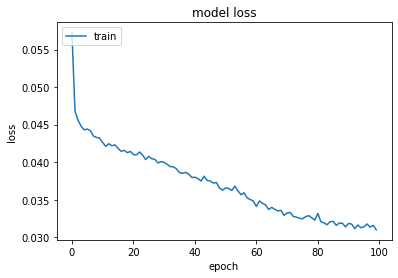

In [52]:
from matplotlib import pyplot as plt

# summarize history for loss
plt.plot(history.history['loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

**Code to save/load the generated model.**

In [53]:
model.save('./models/sixtyfive_fortyfive.h5')  # creates a HDF5 file of the model.
# model = load_model('./models/sixtyfive_fortyfive.h5')

As it can be analyzed, the resulting *Pearson Correlation Coefficient* (0.659) is the best one obtained up to now. This means that the model is able to learn the relations behind the different inserted similarities from the *Train* set and apply them to unseen data from the *Test* set.

It must be noted that the study of this approach can be investigated further applying more input similarities that were not covered in this Notebook or trying to get a better result in the Regression Task without a Neural Network (*e.g.* Support Vector Regression).

## 3. Other proposed approaches

### 3.1 Utilizing other PoS taggers.

The similarities of Lemmas will be explored with different PoS taggers to later compare the results with the `pos_tag` from `nltk`.

In order to avoid the training step, the pre-trained models with 3000 sentences from the treebank corpus saved in the previous lab about PoS taggers will be loaded here using `dill` or `set_model_file(model)`.

#### 3.1.1 Perceptron Model

In [54]:
PER=None
with open("models/per_treebank_pos_tagger_3000", "rb") as f:
    PER = dill.load(f)

The PER tagger will be applied to the tokenized words in order to extract the PoS tags:

In [55]:
pairs_PER = [(PER.tag(p[0]), PER.tag(p[1])) for p in pairs_tokenized]

for index, pair in enumerate(pairs_PER):
    print(str(index + 1) + ".", pair, '\n')

1. ([('The', 'DT'), ('problem', 'NN'), ('likely', 'RB'), ('will', 'MD'), ('mean', 'VB'), ('corrective', 'JJ'), ('changes', 'NNS'), ('before', 'IN'), ('the', 'DT'), ('shuttle', 'NN'), ('fleet', 'NN'), ('starts', 'NNS'), ('flying', 'VBG'), ('again', 'RB'), ('.', '.')], [('He', 'PRP'), ('said', 'VBD'), ('the', 'DT'), ('problem', 'NN'), ('needs', 'VBZ'), ('to', 'TO'), ('be', 'VB'), ('corrected', 'VBN'), ('before', 'IN'), ('the', 'DT'), ('space', 'NN'), ('shuttle', 'NN'), ('fleet', 'NN'), ('is', 'VBZ'), ('cleared', 'VBN'), ('to', 'TO'), ('fly', 'VB'), ('again', 'RB'), ('.', '.')]) 

2. ([('The', 'DT'), ('technology-laced', 'JJ'), ('Nasdaq', 'NNP'), ('Composite', 'NNP'), ('Index', 'NNP'), ('.IXIC', 'NNP'), ('inched', 'VBD'), ('down', 'RB'), ('1', 'CD'), ('point', 'NN'), (',', ','), ('or', 'CC'), ('0.11', 'CD'), ('percent', 'NN'), (',', ','), ('to', 'TO'), ('1,650', 'CD'), ('.', '.')], [('The', 'DT'), ('broad', 'NN'), ('Standard', 'NNP'), ('&', 'CC'), ('Poor', 'NNP'), ("'s", 'POS'), ('500', '

1713. ([('I', 'PRP'), ('am', 'VBP'), ('one', 'CD'), ('of', 'IN'), ('those', 'DT'), ('Members', 'NNS'), ('who', 'WP'), ('attends', 'RB'), ('sittings', 'VBZ'), ('quite', 'RB'), ('faithfully', 'RB'), ('.', '.')], [('I', 'PRP'), ('am', 'VBP'), ('part', 'NN'), ('of', 'IN'), ('parliamentarians', 'NNS'), ('who', 'WP'), ('are', 'VBP'), ('rather', 'RB'), ('present', 'JJ'), ('honourably', 'RB'), ('.', '.')]) 

1714. ([('Mr', 'NNP'), ('President', 'NNP'), (',', ','), ('the', 'DT'), ('Cashman', 'NNP'), ('report', 'NN'), ('can', 'MD'), ('be', 'VB'), ('summarised', 'VBN'), ('in', 'IN'), ('four', 'CD'), ('words', 'NNS'), (':', ':'), ('citizens', 'NNS'), ("'", 'POS'), ('power', 'NN'), ('over', 'IN'), ('bureaucracy', 'NN'), ('.', '.')], [('Mister', 'IN'), ('the', 'DT'), ('President', 'NNP'), (',', ','), ('the', 'DT'), ('report', 'NN'), ('Cashman', 'NNP'), ('can', 'MD'), ('summarize', 'VB'), ('itself', 'PRP'), ('in', 'IN'), ('some', 'DT'), ('words', 'NNS'), (':', ':'), ('the', 'DT'), ('strength', 'NN'),

The PoS tag pairs will be applied with lemmas in lowercase, without stopwords, and getting only the words with the use of regular expression to test the best score.

- `t_pairs`: contains the basic lemmas approach.
- `t_pairs_lower`: contains the `pairs_lemmas` approach in lower case.
- `t_pairs_lower_no_sw`: contains the `t_pairs_lemmas_lower` approach without stopwords.
- `t_pairs_lower_ow`: contains the `t_pairs_lemmas_lower` approach using only words.
- `t_pairs_lower_no_sw_ow`: contains the `t_pairs_lemmas_lower_ow` approach without stopwords.

In [56]:
t_pairs = list()
t_pairs_lower = list()
t_pairs_lower_no_sw = list()
t_pairs_lower_ow = list()
t_pairs_lower_no_sw_ow = list()

for pair in pairs_PER:
    t_pairs.append(([lemmatize(word) for word in pair[0]], [lemmatize(word) for word in pair[1]]))
    t_pairs_lower.append(([lemmatize(word, True) for word in pair[0]],
                          [lemmatize(word, True) for word in pair[1]]))
    t_pairs_lower_no_sw.append(([lemmatize(word, True) for word in pair[0] if word[0].lower() not in sw],
                                [lemmatize(word, True) for word in pair[1] if word[0].lower() not in sw]))
    t_pairs_lower_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0])],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0])]))
    t_pairs_lower_no_sw_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0]) and word[0].lower() not in sw],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0]) and word[0].lower() not in sw]))

for index, t_pair in enumerate(t_pairs):
    print(str(index + 1) + ".", t_pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'change', 'before', 'the', 'shuttle', 'fleet', 'start', 'fly', 'again', '.'], ['He', 'say', 'the', 'problem', 'need', 'to', 'be', 'correct', 'before', 'the', 'space', 'shuttle', 'fleet', 'be', 'clear', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inch', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'standard', '&', 'poor', "'s", '500', 'index', '.spx', 'inch', 'up', '3', 'point', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'say', 'publisher', 'arthur', 'ochs', 'sulzberger', 'jr.', ',', 'whose', 'family', 'have', 'control', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'arthur', 'sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'say', 'of', 'the', 'scandal', '.']) 

4. (['sec', 'ch


1674. (['The', 'european', 'union', 'have', 'get', 'to', 'do', 'something', 'and', 'do', 'it', 'quickly', '.'], ['It', 'be', 'appropriate', 'that', 'the', 'european', 'union', 'be', 'involve', 'and', 'that', 'it', 'make', 'it', 'quickly', '.']) 

1675. (['Neither', 'be', 'there', 'a', 'qualified', 'majority', 'within', 'this', 'house', 'to', 'revert', 'to', 'article', '272', '.'], ['It', 'do', 'not', 'exist', 'not', 'more', 'qualified', 'majority', 'within', 'this', 'parliament', 'to', 'come', 'back', 'to', 'the', 'item', '272', '.']) 

1676. (['There', 'must', 'be', 'a', 'balance', 'as', 'a', 'whole', '.'], ['All', 'must', 'be', 'balance', '.']) 

1677. (['then', 'perhaps', 'we', 'could', 'have', 'avoid', 'a', 'catastrophe', '.'], ['We', 'would', 'perhaps', 'then', 'could', 'prevent', 'a', 'disaster', '.']) 

1678. (['let', 'me', 'remind', 'you', 'that', 'our', 'ally', 'include', 'fervent', 'supporter', 'of', 'this', 'tax', '.'], ['I', 'would', 'remind', 'you', 'that', 'one', 'of', '

After tokenizing the sentences using lemmas, in order to get the similarity between a pair of sentences, the similarities can be computed using [*Jaccard distance*](https://www.nltk.org/api/nltk.metrics.html#nltk.metrics.distance.jaccard_distance).
- `similarities_l`: contains the similarities between each basic pair of lemmas.
- `similarities_l_lower`: contains the `similarities_l` in lowercase.
- `similarities_l_lower_no_sw`: contains the `similarities_l_lower` without stopwords.
- `similarities_l_lower_ow`: contains the `similarities_l_lower` using only words.
- `similarities_l_lower_no_sw_ow`: contains the `similarities_l_lower_ow` without stopwords 

In [57]:
similarities_l = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs]
similarities_l_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower]
similarities_l_lower_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw]
similarities_l_lower_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_ow]
similarities_l_lower_no_sw_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw_ow]

print("Similarities with Perceptron model (considering lemmas):\n")
for index, similarity in enumerate(similarities_l):
    print(str(index + 1) + ".", similarity)

Similarities with Perceptron model (considering lemmas):

1. 0.34782608695652173
2. 0.3214285714285714
3. 0.5555555555555556
4. 0.5909090909090908
5. 0.19999999999999996
6. 0.4878048780487805
7. 0.34782608695652173
8. 0.5405405405405406
9. 0.6428571428571428
10. 0.631578947368421
11. 0.4117647058823529
12. 0.46153846153846156
13. 0.5
14. 0.3846153846153846
15. 0.31999999999999995
16. 0.4516129032258065
17. 0.4054054054054054
18. 0.5217391304347826
19. 0.4444444444444444
20. 0.42307692307692313
21. 0.36363636363636365
22. 0.46875
23. 0.76
24. 0.64
25. 0.43999999999999995
26. 0.6296296296296297
27. 0.6060606060606061
28. 0.2857142857142857
29. 0.38888888888888884
30. 0.4736842105263158
31. 0.6538461538461539
32. 0.4
33. 0.40909090909090906
34. 0.3913043478260869
35. 0.4782608695652174
36. 0.84
37. 0.46153846153846156
38. 0.33333333333333337
39. 0.5161290322580645
40. 0.5666666666666667
41. 0.5333333333333333
42. 0.8518518518518519
43. 0.4545454545454546
44. 0.4482758620689655
45. 0.65517

2580. 0.7142857142857143
2581. 0.8181818181818181
2582. 0.5714285714285714
2583. 0.6428571428571428
2584. 0.6666666666666667
2585. 0.8666666666666667
2586. 0.5454545454545454
2587. 0.625
2588. 0.6666666666666667
2589. 0.6428571428571428
2590. 0.6666666666666667
2591. 0.6666666666666667
2592. 0.8888888888888888
2593. 0.5714285714285714
2594. 0.7692307692307692
2595. 0.7
2596. 0.6666666666666667
2597. 0.75
2598. 0.7
2599. 0.5
2600. 0.625
2601. 0.5
2602. 0.5714285714285714
2603. 0.5555555555555556
2604. 0.75
2605. 0.8235294117647058
2606. 0.6666666666666667
2607. 0.8181818181818181
2608. 0.65625
2609. 0.6153846153846154
2610. 0.5
2611. 0.75
2612. 0.7
2613. 0.6666666666666667
2614. 0.75
2615. 0.75
2616. 0.625
2617. 0.8571428571428572
2618. 0.8
2619. 0.5833333333333333
2620. 0.75
2621. 0.8
2622. 0.6428571428571428
2623. 0.5714285714285714
2624. 0.5
2625. 0.6363636363636364
2626. 0.6363636363636364
2627. 0.6666666666666667
2628. 0.7692307692307692
2629. 0.6363636363636364
2630. 0.66666666666

In [58]:
print("Perceptron Model:")
print("Pearson correlation (lemmas):", pearsonr(gs, similarities_l)[0])
print("Pearson correlation (lemmas + lowercase):", pearsonr(gs, similarities_l_lower)[0])
print("Pearson correlation (lemmas + lowercase + stopwords):", pearsonr(gs, similarities_l_lower_no_sw)[0])
print("Pearson correlation (lemmas + lowercase + just words):", pearsonr(gs, similarities_l_lower_ow)[0])
print("Pearson correlation (lemmas + lowercase + no stopwords + just words):", pearsonr(gs, similarities_l_lower_no_sw_ow)[0])

Perceptron Model:
Pearson correlation (lemmas): 0.40011912484014667
Pearson correlation (lemmas + lowercase): 0.42411285085445644
Pearson correlation (lemmas + lowercase + stopwords): 0.4957729883107995
Pearson correlation (lemmas + lowercase + just words): 0.4897382321438746
Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5791622437200032


#### 3.1.2 CRF Model

In [59]:
CRF = CRFTagger()
CRF.set_model_file('models/crf_treebank_pos_tagger_3000')

In [60]:
pairs_CRF = [(CRF.tag(p[0]), CRF.tag(p[1])) for p in pairs_tokenized]

for index, pair in enumerate(pairs_CRF):
    print(str(index + 1) + ".", pair, '\n')

1. ([('The', 'DT'), ('problem', 'NN'), ('likely', 'RB'), ('will', 'MD'), ('mean', 'VB'), ('corrective', 'JJ'), ('changes', 'NNS'), ('before', 'IN'), ('the', 'DT'), ('shuttle', 'JJ'), ('fleet', 'NN'), ('starts', 'NNS'), ('flying', 'VBG'), ('again', 'RB'), ('.', '.')], [('He', 'PRP'), ('said', 'VBD'), ('the', 'DT'), ('problem', 'NN'), ('needs', 'NNS'), ('to', 'TO'), ('be', 'VB'), ('corrected', 'VBN'), ('before', 'IN'), ('the', 'DT'), ('space', 'NN'), ('shuttle', 'NN'), ('fleet', 'NN'), ('is', 'VBZ'), ('cleared', 'VBN'), ('to', 'TO'), ('fly', 'RB'), ('again', 'RB'), ('.', '.')]) 

2. ([('The', 'DT'), ('technology-laced', 'JJ'), ('Nasdaq', 'NNP'), ('Composite', 'NNP'), ('Index', 'NNP'), ('.IXIC', 'NN'), ('inched', 'VBD'), ('down', 'RB'), ('1', 'CD'), ('point', 'NN'), (',', ','), ('or', 'CC'), ('0.11', 'CD'), ('percent', 'NN'), (',', ','), ('to', 'TO'), ('1,650', 'CD'), ('.', '.')], [('The', 'DT'), ('broad', 'JJ'), ('Standard', 'NNP'), ('&', 'CC'), ('Poor', 'NNP'), ("'s", 'POS'), ('500', 'C


1687. ([('The', 'DT'), ('vote', 'NN'), ('will', 'MD'), ('take', 'VB'), ('place', 'NN'), ('today', 'NN'), ('at', 'IN'), ('5.30', 'CD'), ('p.m', 'NN'), ('.', '.')], [('The', 'DT'), ('vote', 'NN'), ('will', 'MD'), ('take', 'VB'), ('place', 'NN'), ('at', 'IN'), ('5.30', 'CD'), ('p.m', 'NN'), ('.', '.')]) 

1688. ([('Selective', 'JJ'), ('aid', 'NN'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('market', 'NN'), ('support', 'NN'), ('and', 'CC'), ('a', 'DT'), ('grass', 'NN'), ('subsidy', 'NN'), (',', ','), ('are', 'VBP'), ('essential', 'JJ'), ('.', '.')], [('The', 'DT'), ('occasional', 'JJ'), ('aid', 'NN'), ('as', 'IN'), ('the', 'DT'), ('market', 'NN'), ('or', 'CC'), ('the', 'DT'), ('grass', 'NN'), ('is', 'VBZ'), ('essential', 'JJ'), ('.', '.')]) 

1689. ([('Selective', 'JJ'), ('aid', 'NN'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('market', 'NN'), ('support', 'NN'), ('and', 'CC'), ('a', 'DT'), ('grass', 'NN'), ('subsidy', 'NN'), (',', ','), ('are', 'VBP'), ('essential', 'JJ'), ('.', '.')], 

In [61]:
sw = set(stopwords.words('english'))

t_pairs = list()
t_pairs_lower = list()
t_pairs_lower_no_sw = list()
t_pairs_lower_ow = list()
t_pairs_lower_no_sw_ow = list()

for pair in pairs_CRF:
    t_pairs.append(([lemmatize(word) for word in pair[0]], [lemmatize(word) for word in pair[1]]))
    t_pairs_lower.append(([lemmatize(word, True) for word in pair[0]],
                          [lemmatize(word, True) for word in pair[1]]))
    t_pairs_lower_no_sw.append(([lemmatize(word, True) for word in pair[0] if word[0].lower() not in sw],
                                [lemmatize(word, True) for word in pair[1] if word[0].lower() not in sw]))
    t_pairs_lower_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0])],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0])]))
    t_pairs_lower_no_sw_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0]) and word[0].lower() not in sw],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0]) and word[0].lower() not in sw]))
    
for index, t_pair in enumerate(t_pairs):
    print(str(index + 1) + ".", t_pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'change', 'before', 'the', 'shuttle', 'fleet', 'start', 'fly', 'again', '.'], ['He', 'say', 'the', 'problem', 'need', 'to', 'be', 'correct', 'before', 'the', 'space', 'shuttle', 'fleet', 'be', 'clear', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inch', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'standard', '&', 'poor', "'s", '500', 'index', '.spx', 'inch', 'up', '3', 'point', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'say', 'publisher', 'arthur', 'ochs', 'sulzberger', 'jr.', ',', 'whose', 'family', 'have', 'control', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'arthur', 'sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'say', 'of', 'the', 'scandal', '.']) 

4. (['sec', 'ch

1741. (['The', 'european', 'union', 'have', 'get', 'to', 'do', 'something', 'and', 'do', 'it', 'quickly', '.'], ['It', 'be', 'appropriate', 'that', 'the', 'european', 'union', 'mean', 'and', 'that', 'it', 'should', 'do', 'so', 'quickly', '.']) 

1742. (['Let', 'me', 'remind', 'you', 'that', 'our', 'ally', 'include', 'fervent', 'supporter', 'of', 'this', 'tax', '.'], ['I', 'be', 'anxious', 'to', 'recall', 'you', 'that', 'among', 'our', 'ally', ',', 'there', 'be', 'fervent', 'of', 'this', 'tax', '.']) 

1743. (['Selective', 'aid', ',', 'such', 'as', 'market', 'support', 'and', 'a', 'grass', 'subsidy', ',', 'be', 'essential', '.'], ['Punctual', 'help', 'as', 'the', 'support', 'of', 'the', 'market', 'or', 'the', 'bonus', 'at', 'the', 'grass', 'be', 'essential', '.']) 

1744. (['It', 'be', 'our', 'job', 'to', 'continue', 'to', 'support', 'latvia', 'with', 'the', 'integration', 'of', 'the', 'Russian', 'population', '.'], ['It', 'be', 'our', 'duty', 'to', 'continue', 'to', 'support', 'latvia'

In [62]:
similarities_l = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs]
similarities_l_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower]
similarities_l_lower_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw]
similarities_l_lower_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_ow]
similarities_l_lower_no_sw_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw_ow]

print("Similarities with CRF model (considering lemmas):\n")
for index, similarity in enumerate(similarities_l):
    print(str(index + 1) + ".", similarity)

Similarities with CRF model (considering lemmas):

1. 0.34782608695652173
2. 0.3214285714285714
3. 0.5555555555555556
4. 0.5909090909090908
5. 0.19999999999999996
6. 0.4878048780487805
7. 0.34782608695652173
8. 0.5405405405405406
9. 0.5862068965517242
10. 0.631578947368421
11. 0.4117647058823529
12. 0.46153846153846156
13. 0.5
14. 0.3846153846153846
15. 0.31999999999999995
16. 0.4516129032258065
17. 0.4054054054054054
18. 0.5217391304347826
19. 0.4444444444444444
20. 0.42307692307692313
21. 0.4285714285714286
22. 0.4838709677419355
23. 0.76
24. 0.64
25. 0.5
26. 0.6296296296296297
27. 0.65625
28. 0.2857142857142857
29. 0.38888888888888884
30. 0.4736842105263158
31. 0.6538461538461539
32. 0.4
33. 0.40909090909090906
34. 0.3913043478260869
35. 0.4782608695652174
36. 0.84
37. 0.46153846153846156
38. 0.33333333333333337
39. 0.5161290322580645
40. 0.5666666666666667
41. 0.5333333333333333
42. 0.8518518518518519
43. 0.4545454545454546
44. 0.4482758620689655
45. 0.6551724137931034
46. 0.300000

2574. 0.9285714285714286
2575. 0.6666666666666667
2576. 0.5
2577. 0.625
2578. 0.6363636363636364
2579. 0.625
2580. 0.7142857142857143
2581. 0.8181818181818181
2582. 0.5714285714285714
2583. 0.6428571428571428
2584. 0.6666666666666667
2585. 0.8666666666666667
2586. 0.5454545454545454
2587. 0.4444444444444444
2588. 0.6666666666666667
2589. 0.6428571428571428
2590. 0.6666666666666667
2591. 0.6666666666666667
2592. 0.7
2593. 0.5714285714285714
2594. 0.7692307692307692
2595. 0.7
2596. 0.6666666666666667
2597. 0.75
2598. 0.7
2599. 0.5
2600. 0.625
2601. 0.5
2602. 0.5714285714285714
2603. 0.5555555555555556
2604. 0.75
2605. 0.8235294117647058
2606. 0.6666666666666667
2607. 0.5384615384615384
2608. 0.7666666666666666
2609. 0.6153846153846154
2610. 0.5
2611. 0.75
2612. 0.7
2613. 0.6666666666666667
2614. 0.75
2615. 0.75
2616. 0.625
2617. 0.8571428571428572
2618. 0.8
2619. 0.5833333333333333
2620. 0.75
2621. 0.8
2622. 0.6428571428571428
2623. 0.4666666666666667
2624. 0.5
2625. 0.8
2626. 0.63636363

In [63]:
print("CRF Model:")
print("Pearson correlation (lemmas):", pearsonr(gs, similarities_l)[0])
print("Pearson correlation (lemmas + lowercase):", pearsonr(gs, similarities_l_lower)[0])
print("Pearson correlation (lemmas + lowercase + stopwords):", pearsonr(gs, similarities_l_lower_no_sw)[0])
print("Pearson correlation (lemmas + lowercase + just words):", pearsonr(gs, similarities_l_lower_ow)[0])
print("Pearson correlation (lemmas + lowercase + no stopwords + just words):", pearsonr(gs, similarities_l_lower_no_sw_ow)[0])

CRF Model:
Pearson correlation (lemmas): 0.39843504006987385
Pearson correlation (lemmas + lowercase): 0.4224806256272224
Pearson correlation (lemmas + lowercase + stopwords): 0.4952024145788023
Pearson correlation (lemmas + lowercase + just words): 0.4881074417488595
Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5793519278334884


#### 3.1.3 HMM Model

In [64]:
HMM=None
with open("models/hmm_treebank_pos_tagger_3000", "rb") as f:
    HMM = dill.load(f)

In [65]:
pairs_HMM = [(HMM.tag(p[0]), HMM.tag(p[1])) for p in pairs_tokenized]

for index, pair in enumerate(pairs_HMM):
    print(str(index + 1) + ".", pair, '\n')

1. ([('The', 'DT'), ('problem', 'NN'), ('likely', 'JJ'), ('will', 'NNP'), ('mean', 'NNP'), ('corrective', 'NNP'), ('changes', 'NNP'), ('before', 'NNP'), ('the', 'NNP'), ('shuttle', 'NNP'), ('fleet', 'NNP'), ('starts', 'NNP'), ('flying', 'NNP'), ('again', 'NNP'), ('.', 'NNP')], [('He', 'PRP'), ('said', 'VBD'), ('the', 'DT'), ('problem', 'NN'), ('needs', 'VBZ'), ('to', 'TO'), ('be', 'VB'), ('corrected', 'VBN'), ('before', 'IN'), ('the', 'DT'), ('space', 'NN'), ('shuttle', 'NNP'), ('fleet', 'NNP'), ('is', 'NNP'), ('cleared', 'NNP'), ('to', 'NNP'), ('fly', 'NNP'), ('again', 'NNP'), ('.', 'NNP')]) 

2. ([('The', 'DT'), ('technology-laced', 'NNP'), ('Nasdaq', 'NNP'), ('Composite', 'NNP'), ('Index', 'NNP'), ('.IXIC', 'NNP'), ('inched', 'NNP'), ('down', 'NNP'), ('1', 'NNP'), ('point', 'NNP'), (',', 'NNP'), ('or', 'NNP'), ('0.11', 'NNP'), ('percent', 'NNP'), (',', 'NNP'), ('to', 'NNP'), ('1,650', 'NNP'), ('.', 'NNP')], [('The', 'DT'), ('broad', 'JJ'), ('Standard', 'NNP'), ('&', 'CC'), ('Poor', 

1789. ([('Consumers', 'NNP'), ('will', 'NNP'), ('lose', 'NNP'), ('out', 'NNP'), (',', 'NNP'), ('employees', 'NNP'), ('will', 'NNP'), ('lose', 'NNP'), ('out', 'NNP'), (',', 'NNP'), ('Europe', 'NNP'), ('will', 'NNP'), ('lose', 'NNP'), ('competitive', 'NNP'), ('strength', 'NNP'), ('and', 'NNP'), ('growth', 'NNP'), ('.', 'NNP')], [('The', 'DT'), ('users', 'NNS'), ('will', 'MD'), ('be', 'VB'), ('the', 'DT'), ('losers', 'NNP'), (',', 'NNP'), ('with', 'NNP'), ('the', 'NNP'), ('employees', 'NNP'), (',', 'NNP'), ('and', 'NNP'), ('European', 'NNP'), ('competitiveness', 'NNP'), ('and', 'NNP'), ('the', 'NNP'), ('growth', 'NNP'), ('will', 'NNP'), ('regress', 'NNP'), ('.', 'NNP')]) 

1790. ([('The', 'DT'), ('standards', 'NNS'), ('are', 'VBP'), ('scarcely', 'RB'), ('comparable', 'JJ'), (',', ','), ('let', 'VBD'), ('alone', 'RB'), ('transferable', 'NNP'), ('.', 'NNP')], [('The', 'DT'), ('standards', 'NNS'), ('are', 'VBP'), ('hardly', 'RB'), ('comparable', 'JJ'), ('and', 'CC'), ('even', 'RB'), ('less',

In [66]:
t_pairs = list()
t_pairs_lower = list()
t_pairs_lower_no_sw = list()
t_pairs_lower_ow = list()
t_pairs_lower_no_sw_ow = list()

for pair in pairs_HMM:
    t_pairs.append(([lemmatize(word) for word in pair[0]], [lemmatize(word) for word in pair[1]]))
    t_pairs_lower.append(([lemmatize(word, True) for word in pair[0]],
                          [lemmatize(word, True) for word in pair[1]]))
    t_pairs_lower_no_sw.append(([lemmatize(word, True) for word in pair[0] if word[0].lower() not in sw],
                                [lemmatize(word, True) for word in pair[1] if word[0].lower() not in sw]))
    t_pairs_lower_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0])],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0])]))
    t_pairs_lower_no_sw_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0]) and word[0].lower() not in sw],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0]) and word[0].lower() not in sw]))
    
for index, t_pair in enumerate(t_pairs):
    print(str(index + 1) + ".", t_pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'change', 'before', 'the', 'shuttle', 'fleet', 'start', 'flying', 'again', '.'], ['He', 'say', 'the', 'problem', 'need', 'to', 'be', 'correct', 'before', 'the', 'space', 'shuttle', 'fleet', 'is', 'cleared', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'nasdaq', 'composite', 'index', '.ixic', 'inched', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'standard', '&', 'poor', "'s", '500', 'index', '.spx', 'inched', 'up', '3', 'point', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'say', 'publisher', 'arthur', 'ochs', 'sulzberger', 'jr.', ',', 'whose', 'family', 'ha', 'controlled', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'arthur', 'sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'said', 'of', 'the', 'scandal', '.']) 

4. (

1682. (['There', 'must', 'be', 'a', 'balance', 'as', 'a', 'whole', '.'], ['The', 'whole', 'must', 'be', 'in', 'balance', '.']) 

1683. (['selective', 'aid', ',', 'such', 'a', 'market', 'support', 'and', 'a', 'grass', 'subsidy', ',', 'are', 'essential', '.'], ['The', 'specific', 'aid', 'as', 'the', 'support', 'of', 'the', 'market', 'or', 'the', 'premium', 'to', 'the', 'grass', 'are', 'essential', '.']) 

1684. (['mr', 'president', ',', 'i', 'rise', 'in', 'defence', 'of', 'the', 'worker', 'in', 'the', 'industry', '.'], ['mister', 'preside', 'over', 'it', ',', 'i', 'insist', 'on', 'taking', 'the', 'defense', 'of', 'the', 'worker', 'of', 'this', 'sector', '.']) 

1685. (['It', 'increase', 'the', 'power', 'of', 'the', 'big', 'country', 'at', 'the', 'expense', 'of', 'the', 'small', 'country', '.'], ['That', 'have', 'for', 'effect', 'to', 'increase', 'the', 'power', 'of', 'the', 'big', 'country', 'to', 'the', 'detriment', 'of', 'the', 'small', 'one', '.']) 

1686. (['let', 'me', 'remind', 'yo

In [67]:
similarities_l = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs]
similarities_l_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower]
similarities_l_lower_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw]
similarities_l_lower_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_ow]
similarities_l_lower_no_sw_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw_ow]

print("Similarities with HMM model (considering lemmas):\n")
for index, similarity in enumerate(similarities_l):
    print(str(index + 1) + ".", similarity)

Similarities with HMM model (considering lemmas):

1. 0.28
2. 0.3214285714285714
3. 0.5
4. 0.5652173913043479
5. 0.19999999999999996
6. 0.4878048780487805
7. 0.34782608695652173
8. 0.5405405405405406
9. 0.6428571428571428
10. 0.47619047619047616
11. 0.4117647058823529
12. 0.40740740740740744
13. 0.5
14. 0.3846153846153846
15. 0.3076923076923077
16. 0.4516129032258065
17. 0.38888888888888884
18. 0.5
19. 0.368421052631579
20. 0.42307692307692313
21. 0.4285714285714286
22. 0.46875
23. 0.7307692307692308
24. 0.64
25. 0.43999999999999995
26. 0.6538461538461539
27. 0.65625
28. 0.2857142857142857
29. 0.3783783783783784
30. 0.5555555555555556
31. 0.6538461538461539
32. 0.33333333333333337
33. 0.47619047619047616
34. 0.3913043478260869
35. 0.4782608695652174
36. 0.6785714285714286
37. 0.46153846153846156
38. 0.28
39. 0.5161290322580645
40. 0.5666666666666667
41. 0.5333333333333333
42. 0.8214285714285714
43. 0.4545454545454546
44. 0.3548387096774194
45. 0.6551724137931034
46. 0.25806451612903225

2120. 0.04761904761904767
2121. 0.25
2122. 0.0625
2123. 0.14814814814814814
2124. 0.09999999999999998
2125. 0.15384615384615385
2126. 0.16666666666666663
2127. 0.18181818181818177
2128. 0.4444444444444444
2129. 0.19999999999999996
2130. 0.15384615384615385
2131. 0.1578947368421053
2132. 0.0714285714285714
2133. 0.05555555555555558
2134. 0.0
2135. 0.15384615384615385
2136. 0.3125
2137. 0.125
2138. 0.2857142857142857
2139. 0.15384615384615385
2140. 0.09999999999999998
2141. 0.30000000000000004
2142. 0.0714285714285714
2143. 0.19999999999999996
2144. 0.04761904761904767
2145. 0.16666666666666663
2146. 0.1333333333333333
2147. 0.09090909090909094
2148. 0.09523809523809523
2149. 0.2222222222222222
2150. 0.09090909090909094
2151. 0.0714285714285714
2152. 0.2222222222222222
2153. 0.09090909090909094
2154. 0.07692307692307687
2155. 0.13636363636363635
2156. 0.125
2157. 0.07692307692307687
2158. 0.11764705882352944
2159. 0.25
2160. 0.25
2161. 0.09999999999999998
2162. 0.09999999999999998
2163. 

In [68]:
print("HMM Model:")
print("Pearson correlation (lemmas):", pearsonr(gs, similarities_l)[0])
print("Pearson correlation (lemmas + lowercase):", pearsonr(gs, similarities_l_lower)[0])
print("Pearson correlation (lemmas + lowercase + stopwords):", pearsonr(gs, similarities_l_lower_no_sw)[0])
print("Pearson correlation (lemmas + lowercase + just words):", pearsonr(gs, similarities_l_lower_ow)[0])
print("Pearson correlation (lemmas + lowercase + no stopwords + just words):", pearsonr(gs, similarities_l_lower_no_sw_ow)[0])

HMM Model:
Pearson correlation (lemmas): 0.42064175063715115
Pearson correlation (lemmas + lowercase): 0.44158527148054233
Pearson correlation (lemmas + lowercase + stopwords): 0.5019694764546905
Pearson correlation (lemmas + lowercase + just words): 0.5004582386618289
Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5799091513800003


#### 3.1.4 TnT Model

In [69]:
TnT=None
with open("models/tnt_treebank_pos_tagger_3000", "rb") as f:
    TnT = dill.load(f)

In [70]:
pairs_TnT = [(TnT.tag(p[0]), TnT.tag(p[1])) for p in pairs_tokenized]

for index, pair in enumerate(pairs_TnT):
    print(str(index + 1) + ".", pair, '\n')

1. ([('The', 'DT'), ('problem', 'NN'), ('likely', 'RB'), ('will', 'MD'), ('mean', 'VB'), ('corrective', 'Unk'), ('changes', 'NNS'), ('before', 'IN'), ('the', 'DT'), ('shuttle', 'Unk'), ('fleet', 'Unk'), ('starts', 'VBZ'), ('flying', 'Unk'), ('again', 'RB'), ('.', '.')], [('He', 'PRP'), ('said', 'VBD'), ('the', 'DT'), ('problem', 'NN'), ('needs', 'VBZ'), ('to', 'TO'), ('be', 'VB'), ('corrected', 'VBN'), ('before', 'IN'), ('the', 'DT'), ('space', 'NN'), ('shuttle', 'Unk'), ('fleet', 'Unk'), ('is', 'VBZ'), ('cleared', 'Unk'), ('to', 'TO'), ('fly', 'VB'), ('again', 'RB'), ('.', '.')]) 

2. ([('The', 'DT'), ('technology-laced', 'Unk'), ('Nasdaq', 'NNP'), ('Composite', 'Unk'), ('Index', 'NN'), ('.IXIC', 'Unk'), ('inched', 'VBD'), ('down', 'RP'), ('1', 'CD'), ('point', 'NN'), (',', ','), ('or', 'CC'), ('0.11', 'Unk'), ('percent', 'Unk'), (',', ','), ('to', 'TO'), ('1,650', 'Unk'), ('.', '.')], [('The', 'DT'), ('broad', 'JJ'), ('Standard', 'NNP'), ('&', 'CC'), ('Poor', 'NNP'), ("'s", 'POS'), (

1636. ([('The', 'DT'), ('vote', 'NN'), ('will', 'MD'), ('take', 'VB'), ('place', 'NN'), ('today', 'NN'), ('at', 'IN'), ('5.30', 'Unk'), ('p.m', 'RB'), ('.', '.')], [('The', 'DT'), ('vote', 'NN'), ('will', 'MD'), ('take', 'VB'), ('place', 'NN'), ('at', 'IN'), ('5.30', 'Unk'), ('p.m', 'RB'), ('.', '.')]) 

1637. ([('The', 'DT'), ('standards', 'NNS'), ('are', 'VBP'), ('scarcely', 'RB'), ('comparable', 'JJ'), (',', ','), ('let', 'VBD'), ('alone', 'RB'), ('transferable', 'Unk'), ('.', '.')], [('The', 'DT'), ('standards', 'NNS'), ('are', 'VBP'), ('hardly', 'RB'), ('comparable', 'JJ'), ('and', 'CC'), ('even', 'RB'), ('less', 'JJR'), ('transferable', 'Unk'), ('.', '.')]) 

1638. ([('The', 'DT'), ('leaders', 'NNS'), ('have', 'VBP'), ('now', 'RB'), ('been', 'VBN'), ('given', 'VBN'), ('a', 'DT'), ('new', 'JJ'), ('chance', 'NN'), ('and', 'CC'), ('let', 'VB'), ('us', 'PRP'), ('hope', 'VBP'), ('they', 'PRP'), ('seize', 'VB'), ('it', 'PRP'), ('.', '.')], [('The', 'DT'), ('leaders', 'NNS'), ('have', '

2984. ([('That', 'DT'), ('is', 'VBZ'), ('the', 'DT'), ('spirit', 'NN'), ('in', 'IN'), ('which', 'WDT'), ('the', 'DT'), ('European', 'JJ'), ('Constitution', 'NNP'), ('must', 'MD'), ('be', 'VB'), ('written', 'VBN'), ('.', '.')], [('That', 'DT'), ('is', 'VBZ'), ('the', 'DT'), ('spirit', 'NN'), ('in', 'IN'), ('which', 'WDT'), ('must', 'MD'), ('be', 'VB'), ('drawn', 'VBN'), ('up', 'RP'), ('the', 'DT'), ('Constitution', 'NNP'), ('.', '.')]) 

2985. ([('Moreover', 'RB'), (',', ','), ('the', 'DT'), ('main', 'JJ'), ('oil', 'NN'), ('exporters', 'Unk'), ('are', 'VBP'), ('unwilling', 'JJ'), ('to', 'TO'), ('subordinate', 'JJ'), ('their', 'PRP$'), ('investment', 'NN'), ('policies', 'NNS'), ('to', 'TO'), ('market', 'NN'), ('requirements', 'NNS'), ('.', '.')], [('Moreover', 'RB'), (',', ','), ('the', 'DT'), ('major', 'JJ'), ('oil', 'NN'), ('exporters', 'Unk'), ('are', 'VBP'), ('not', 'RB'), ('prepared', 'VBN'), ('to', 'TO'), ('submit', 'VB'), ('their', 'PRP$'), ('investment', 'NN'), ('policies', 'NNS'

In [71]:
t_pairs = list()
t_pairs_lower = list()
t_pairs_lower_no_sw = list()
t_pairs_lower_ow = list()
t_pairs_lower_no_sw_ow = list()

for pair in pairs_TnT:
    t_pairs.append(([lemmatize(word) for word in pair[0]], [lemmatize(word) for word in pair[1]]))
    t_pairs_lower.append(([lemmatize(word, True) for word in pair[0]],
                          [lemmatize(word, True) for word in pair[1]]))
    t_pairs_lower_no_sw.append(([lemmatize(word, True) for word in pair[0] if word[0].lower() not in sw],
                                [lemmatize(word, True) for word in pair[1] if word[0].lower() not in sw]))
    t_pairs_lower_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0])],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0])]))
    t_pairs_lower_no_sw_ow.append(([lemmatize(word, True) for word in pair[0] if re.search(r"\w", word[0]) and word[0].lower() not in sw],
                             [lemmatize(word, True) for word in pair[1] if re.search(r"\w", word[0]) and word[0].lower() not in sw]))
    
for index, t_pair in enumerate(t_pairs):
    print(str(index + 1) + ".", t_pair, '\n')

1. (['The', 'problem', 'likely', 'will', 'mean', 'corrective', 'change', 'before', 'the', 'shuttle', 'fleet', 'start', 'flying', 'again', '.'], ['He', 'say', 'the', 'problem', 'need', 'to', 'be', 'correct', 'before', 'the', 'space', 'shuttle', 'fleet', 'be', 'cleared', 'to', 'fly', 'again', '.']) 

2. (['The', 'technology-laced', 'nasdaq', 'Composite', 'index', '.IXIC', 'inch', 'down', '1', 'point', ',', 'or', '0.11', 'percent', ',', 'to', '1,650', '.'], ['The', 'broad', 'standard', '&', 'poor', "'s", '500', 'index', '.SPX', 'inch', 'up', '3', 'point', ',', 'or', '0.32', 'percent', ',', 'to', '970', '.']) 

3. (['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'say', 'publisher', 'arthur', 'Ochs', 'Sulzberger', 'jr.', ',', 'whose', 'family', 'have', 'controlled', 'the', 'paper', 'since', '1896', '.'], ['``', 'It', "'s", 'a', 'huge', 'black', 'eye', ',', "''", 'arthur', 'Sulzberger', ',', 'the', 'newspaper', "'s", 'publisher', ',', 'say', 'of', 'the', 'scandal', '.']) 

4. (['s

1688. (['Selective', 'aid', ',', 'such', 'as', 'market', 'support', 'and', 'a', 'grass', 'subsidy', ',', 'be', 'essential', '.'], ['The', 'occasional', 'aid', 'as', 'the', 'market', 'or', 'the', 'grass', 'be', 'essential', '.']) 

1689. (['Selective', 'aid', ',', 'such', 'as', 'market', 'support', 'and', 'a', 'grass', 'subsidy', ',', 'be', 'essential', '.'], ['Specific', 'aid', 'as', 'the', 'market', 'or', 'the', 'premium', 'on', 'grass', 'be', 'essential', '.']) 

1690. (['Thank', 'you', ',', 'Commissioner', '.'], ['Thank', 'you', ',', 'Mister', 'Commissioner', '.']) 

1691. (['We', 'often', 'pontificate', 'here', 'about', 'be', 'the', 'representative', 'of', 'the', 'citizen', 'of', 'europe', '.'], ['We', 'often', 'take', 'pride', 'here', 'to', 'represent', 'the', 'citizen', 'of', 'europe', '.']) 

1692. (['Tunisia'], ['Tunisia']) 

1693. (['Tunisia'], ['Tunisia']) 

1694. (['Maij-Weggen', 'report', '(', 'A5-0323/2000', ')'], ['Maij-Weggen', 'report', '(', 'A5-0323', '/', '2000', ')']

In [72]:
similarities_l = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs]
similarities_l_lower = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower]
similarities_l_lower_no_sw = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw]
similarities_l_lower_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_ow]
similarities_l_lower_no_sw_ow = [1 - jaccard_distance(set(p[0]), set(p[1])) for p in t_pairs_lower_no_sw_ow]

print("Similarities with TnT model (considering lemmas):\n")
for index, similarity in enumerate(similarities_l):
    print(str(index + 1) + ".", similarity)

Similarities with TnT model (considering lemmas):

1. 0.29166666666666663
2. 0.3214285714285714
3. 0.5555555555555556
4. 0.5909090909090908
5. 0.19999999999999996
6. 0.4878048780487805
7. 0.34782608695652173
8. 0.5405405405405406
9. 0.6428571428571428
10. 0.631578947368421
11. 0.4117647058823529
12. 0.40740740740740744
13. 0.5
14. 0.3846153846153846
15. 0.31999999999999995
16. 0.4516129032258065
17. 0.4054054054054054
18. 0.5217391304347826
19. 0.4444444444444444
20. 0.42307692307692313
21. 0.4285714285714286
22. 0.4242424242424242
23. 0.76
24. 0.64
25. 0.5
26. 0.5714285714285714
27. 0.65625
28. 0.2857142857142857
29. 0.38888888888888884
30. 0.4736842105263158
31. 0.6538461538461539
32. 0.4
33. 0.47619047619047616
34. 0.3913043478260869
35. 0.4782608695652174
36. 0.84
37. 0.52
38. 0.33333333333333337
39. 0.5161290322580645
40. 0.5666666666666667
41. 0.5333333333333333
42. 0.8518518518518519
43. 0.4545454545454546
44. 0.4482758620689655
45. 0.6551724137931034
46. 0.30000000000000004
47.

2530. 0.8
2531. 0.6470588235294117
2532. 0.7777777777777778
2533. 0.5555555555555556
2534. 0.65
2535. 0.5
2536. 0.625
2537. 0.625
2538. 0.8947368421052632
2539. 0.7
2540. 0.6
2541. 0.5714285714285714
2542. 0.6428571428571428
2543. 0.6
2544. 0.6363636363636364
2545. 0.6666666666666667
2546. 0.5555555555555556
2547. 0.5
2548. 0.125
2549. 0.625
2550. 0.6
2551. 0.625
2552. 0.6153846153846154
2553. 0.7272727272727273
2554. 0.5
2555. 0.6
2556. 0.75
2557. 0.7142857142857143
2558. 0.6666666666666667
2559. 0.4285714285714286
2560. 0.6666666666666667
2561. 0.7333333333333334
2562. 0.5555555555555556
2563. 0.75
2564. 0.8333333333333334
2565. 0.9166666666666666
2566. 0.75
2567. 0.6666666666666667
2568. 0.5555555555555556
2569. 0.6666666666666667
2570. 0.7142857142857143
2571. 0.5
2572. 0.625
2573. 0.5454545454545454
2574. 0.8
2575. 0.6666666666666667
2576. 0.6666666666666667
2577. 0.625
2578. 0.6363636363636364
2579. 0.625
2580. 0.7142857142857143
2581. 0.8181818181818181
2582. 0.375
2583. 0.64285

In [73]:
print("TnT Model:")
print("Pearson correlation (lemmas):", pearsonr(gs, similarities_l)[0])
print("Pearson correlation (lemmas + lowercase):", pearsonr(gs, similarities_l_lower)[0])
print("Pearson correlation (lemmas + lowercase + stopwords):", pearsonr(gs, similarities_l_lower_no_sw)[0])
print("Pearson correlation (lemmas + lowercase + just words):", pearsonr(gs, similarities_l_lower_ow)[0])
print("Pearson correlation (lemmas + lowercase + no stopwords + just words):", pearsonr(gs, similarities_l_lower_no_sw_ow)[0])

TnT Model:
Pearson correlation (lemmas): 0.39083332052677733
Pearson correlation (lemmas + lowercase): 0.4217939387846863
Pearson correlation (lemmas + lowercase + stopwords): 0.4976261679445746
Pearson correlation (lemmas + lowercase + just words): 0.48481345178385554
Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5772464063000191


In the image bellow, it is shown the behaviour of the PoS taggers models pre-trained in previous lab and used for the exploration of the best PoS tagger. The score raking is shown as follows: `Perceptron model > CRF model > TnT model > HMM model`

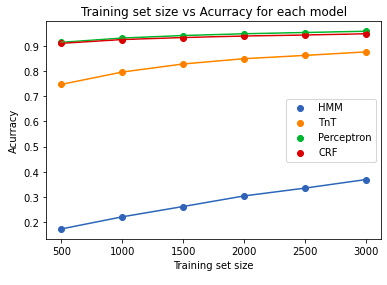

Therefore, the HMM model is expected to perform poorly with respect to the others PoS taggers. Surprisingly, the **HMM model** performed with a *pearson correlation* score of `0.579`, one of the highest between them,. However, with a quick look at the pairs tagged, it is evident that the taggin done by the HMM is wrongly performed. The majority of the tags are `NNP`. This behaviour of the `WordNetLemmatizer` allows the word to be returned as it is if no lemma is found with that pos_tag. So the decieving result is explained in this manner.

With respect to PoS taggers, a comparison of different pre-trained models was explored and with the results obtained above it can be clearly seen the PoS tagger with the best performance was the `nltk pos_tag`. The best score results for each model can be found bellow:

- TnT Model:
    Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5772464063000188

- ~~HMM Model:
    Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5799091513800002~~
- CRF Model:
    Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5793519278334884
- Perceptron Model:
    Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.5791622437200036

- `nltk pos_tag`:
    Pearson correlation (lemmas + lowercase + no stopwords + just words): 0.586937336572258
    
For this reason the combination approaches to find a better *pearson correlation coefficient* were explored only with the `nltk pos_tag`.

## 4. Conclusions

All approaches include conclusions about their performance, including the results achieved by these approaches among them and among the official results using the *Pearson Correlation Coefficient*. For that reason, this section is not devoted to repeat the same explanation for every described approach, but for explaining briefly some final notes about the Semantic Textual Similarity.

First, it should be noted that several approaches have been tested in this *Jupyter Notebook*, including combinations of them. It has been taken into account the lexical and the syntactic dimension for this purpose.

On the other hand, regarding the results, these are the best approaches (each of them have been already explained in their respective sections):


|                           Approach                           | Pearson Correlation Coefficient |
| :----------------------------------------------------------: | :-----------------------------: |
| Neural Network of Similarities [(Section 2.3.4)](#2.3.4-Similarities-Neural-Network) |              0.659              |
| Weighted Combination of Similarities [(Section 2.3.3)](#2.3.3-Weighted-Combination-of-Similarities) |              0.589              |
| Lemmas + Minor Changes [(Section 2.1.2)](#2.1.2-Lemma-tokenization-(PoS)) |              0.587              |
| Words Tokenization + Minor Changes [(Section 2.1.1)](#2.1.1-Words-tokenization) |              0.561              |
| Word Sequences + Lemmas + Minor Changes [(Section 2.3.1)](#2.3.1-Combination-of-Word-Sequences-and-Lemmas) |              0.554              |

Finally, the obtained results from this project and from the State of the Art endorse the fact that Semantic Textual Similarity (Paraphrase Detection) is an interesting complex task in the Natural Language Processing field. The implemented approaches are just the baseline of several improvements that can be made and are discovered each year thanks to the evolution that exists in scientific fields related to Artificial Intelligence. 

# Main Bibliography & Tools

[1] [IHLT Laboratory Webpage](https://gebakx.github.io/ihlt/#1)

[2] [NLTK (Natural Language Toolkit)](https://www.nltk.org/)

[3] [Stanford CoreNLP](https://stanfordnlp.github.io/CoreNLP/)

[4] [SemEval-2012](https://www.cs.york.ac.uk/semeval-2012/)

[5] [Jupyter Notebook](https://jupyter.org/)